# DataSet explanation:

## The columns:
###**For Generation Data**:

DATE_TIME:  Date and time for each observation. Observations recorded at 15 minute intervals.

PLANT_ID : ID of Solar Power Plant

SOURCE_KEY: Inverter ID

DC_POWER: power input to the inverter (SOURCE_KEY) at interval (in kW)

AC_POWER: power generated by the inverter (SOURCE_KEY) at interval (in kW)

DAILY_YIELD:shows how much energy has been generated so far on a given day

This is the cumulative sum of the energy generated since the start of the current day (midnight).
It resets to zero at the beginning of each day and accumulates throughout the day for each 15-minute interval.


TOTAL_YIELD:reflects the lifetime energy generation of the inverter up to the recorded timestamp.

This is the overall cumulative energy generated by the inverter (represented by SOURCE_KEY) from the time it started operating until the current observation time.
It keeps increasing across days and does not reset, unless the system is reset or reinitialized.







###**For Weather Sensor Data**
DATE_TIME:  Date and time for each observation. Observations recorded at 15 minute intervals

PLANT_ID: ID of Solar Power Plant (common for the entire file)

SOURCE_KEY: Sensor panel ID (Common for entire file, only one type of sensor panel for the plant)

AMBIENT_TEMPERATURE: The air temperature surrounding the solar plant.
Useful for analyzing how external temperature impacts power generation and inverter performance.


MODULE_TEMPERATURE: The temperature of the module attached to the sensor panel.


IRRADIATION: Amount of irradiation for the 15 minute interval


# import libraries and Dataset

In [1]:
import pandas as pd
import seaborn as sns
import warnings
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
import plotly.graph_objs as go

warnings.filterwarnings("ignore")

In [2]:
generation_data1= pd.read_csv('/Users/afnanalamri/Renewable_Energy/raw_data/Plant_1_Generation_Data.csv')

In [3]:
generation_data2= pd.read_csv('/Users/afnanalamri/Renewable_Energy/raw_data/Plant_2_Generation_Data.csv')

In [4]:
weather_data1= pd.read_csv('/Users/afnanalamri/Renewable_Energy/raw_data/Plant_1_Weather_Sensor_Data.csv')

In [5]:
weather_data2= pd.read_csv('/Users/afnanalamri/Renewable_Energy/raw_data/Plant_2_Weather_Sensor_Data.csv')

# The diffrent beteewn the first dataset and the second of Generation Data




# EDA for generation_data1

In [6]:
generation_data1.head(5)

,DATE_TIME,PLANT_ID,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
0,15-05-2020 00:00,4135001,1BY6WEcLGh8j5v7,0.0,0.0,0.0,6259559.0
1,15-05-2020 00:00,4135001,1IF53ai7Xc0U56Y,0.0,0.0,0.0,6183645.0
2,15-05-2020 00:00,4135001,3PZuoBAID5Wc2HD,0.0,0.0,0.0,6987759.0
3,15-05-2020 00:00,4135001,7JYdWkrLSPkdwr4,0.0,0.0,0.0,7602960.0
4,15-05-2020 00:00,4135001,McdE0feGgRqW7Ca,0.0,0.0,0.0,7158964.0


In [7]:
generation_data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68778 entries, 0 to 68777
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   DATE_TIME    68778 non-null  object 
 1   PLANT_ID     68778 non-null  int64  
 2   SOURCE_KEY   68778 non-null  object 
 3   DC_POWER     68778 non-null  float64
 4   AC_POWER     68778 non-null  float64
 5   DAILY_YIELD  68778 non-null  float64
 6   TOTAL_YIELD  68778 non-null  float64
dtypes: float64(4), int64(1), object(2)
memory usage: 3.7+ MB


In [8]:
generation_data1.describe()

,PLANT_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
count,68778.0,68778.000000,68778.000000,68778.000000,6.877800e+04
mean,4135001.0,3147.426211,307.802752,3295.968737,6.978712e+06
std,0.0,4036.457169,394.396439,3145.178309,4.162720e+05
min,4135001.0,0.000000,0.000000,0.000000,6.183645e+06
25%,4135001.0,0.000000,0.000000,0.000000,6.512003e+06
50%,4135001.0,429.000000,41.493750,2658.714286,7.146685e+06
75%,4135001.0,6366.964286,623.618750,6274.000000,7.268706e+06
max,4135001.0,14471.125000,1410.950000,9163.000000,7.846821e+06


In [9]:
generation_data1.isnull().sum()

DATE_TIME      0
PLANT_ID       0
SOURCE_KEY     0
DC_POWER       0
AC_POWER       0
DAILY_YIELD    0
TOTAL_YIELD    0
dtype: int64

In [10]:
generation_data1['PLANT_ID'].value_counts()

PLANT_ID
4135001    68778
Name: count, dtype: int64

In [11]:
generation_data1['PLANT_ID'].nunique()

1

In [12]:
generation_data1['SOURCE_KEY'].nunique()

22

In [13]:
generation_data1['SOURCE_KEY'].value_counts()

SOURCE_KEY
bvBOhCH3iADSZry    3155
1BY6WEcLGh8j5v7    3154
7JYdWkrLSPkdwr4    3133
VHMLBKoKgIrUVDU    3133
ZnxXDlPa8U1GXgE    3130
ih0vzX44oOqAx2f    3130
z9Y9gH1T5YWrNuG    3126
wCURE6d3bPkepu2    3126
uHbuxQJl8lW7ozc    3125
pkci93gMrogZuBj    3125
iCRJl6heRkivqQ3    3125
rGa61gmuvPhdLxV    3124
sjndEbLyjtCKgGv    3124
McdE0feGgRqW7Ca    3124
zVJPv84UY57bAof    3124
ZoEaEvLYb1n2sOq    3123
1IF53ai7Xc0U56Y    3119
adLQvlD726eNBSB    3119
zBIq5rxdHJRwDNY    3119
WRmjgnKYAwPKWDb    3118
3PZuoBAID5Wc2HD    3118
YxYtjZvoooNbGkE    3104
Name: count, dtype: int64

In [14]:
generation_data1['DATE_TIME'] = pd.to_datetime(generation_data1['DATE_TIME'], format='%d-%m-%Y %H:%M')

In [15]:
generation_data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68778 entries, 0 to 68777
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   DATE_TIME    68778 non-null  datetime64[ns]
 1   PLANT_ID     68778 non-null  int64         
 2   SOURCE_KEY   68778 non-null  object        
 3   DC_POWER     68778 non-null  float64       
 4   AC_POWER     68778 non-null  float64       
 5   DAILY_YIELD  68778 non-null  float64       
 6   TOTAL_YIELD  68778 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(1), object(1)
memory usage: 3.7+ MB


In [16]:
generation_data1.duplicated().sum()

0

# EDA for generation_data2

In [17]:
generation_data2.head(5)

,DATE_TIME,PLANT_ID,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
0,2020-05-15 00:00:00,4136001,4UPUqMRk7TRMgml,0.0,0.0,9425.000000,2.429011e+06
1,2020-05-15 00:00:00,4136001,81aHJ1q11NBPMrL,0.0,0.0,0.000000,1.215279e+09
2,2020-05-15 00:00:00,4136001,9kRcWv60rDACzjR,0.0,0.0,3075.333333,2.247720e+09
3,2020-05-15 00:00:00,4136001,Et9kgGMDl729KT4,0.0,0.0,269.933333,1.704250e+06
4,2020-05-15 00:00:00,4136001,IQ2d7wF4YD8zU1Q,0.0,0.0,3177.000000,1.994153e+07


In [18]:
generation_data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67698 entries, 0 to 67697
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   DATE_TIME    67698 non-null  object 
 1   PLANT_ID     67698 non-null  int64  
 2   SOURCE_KEY   67698 non-null  object 
 3   DC_POWER     67698 non-null  float64
 4   AC_POWER     67698 non-null  float64
 5   DAILY_YIELD  67698 non-null  float64
 6   TOTAL_YIELD  67698 non-null  float64
dtypes: float64(4), int64(1), object(2)
memory usage: 3.6+ MB


In [19]:
generation_data2.isnull().sum()

DATE_TIME      0
PLANT_ID       0
SOURCE_KEY     0
DC_POWER       0
AC_POWER       0
DAILY_YIELD    0
TOTAL_YIELD    0
dtype: int64

In [20]:
generation_data2.describe()

,PLANT_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
count,67698.0,67698.000000,67698.000000,67698.000000,6.769800e+04
mean,4136001.0,246.701961,241.277825,3294.890295,6.589448e+08
std,0.0,370.569597,362.112118,2919.448386,7.296678e+08
min,4136001.0,0.000000,0.000000,0.000000,0.000000e+00
25%,4136001.0,0.000000,0.000000,272.750000,1.996494e+07
50%,4136001.0,0.000000,0.000000,2911.000000,2.826276e+08
75%,4136001.0,446.591667,438.215000,5534.000000,1.348495e+09
max,4136001.0,1420.933333,1385.420000,9873.000000,2.247916e+09


In [21]:
generation_data2['SOURCE_KEY'].nunique()

22

In [22]:
generation_data2['PLANT_ID'].nunique()

1

In [23]:
generation_data2['DATE_TIME'] = pd.to_datetime(generation_data2['DATE_TIME'], format='%Y-%m-%d %H:%M:%S')

In [24]:
generation_data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67698 entries, 0 to 67697
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   DATE_TIME    67698 non-null  datetime64[ns]
 1   PLANT_ID     67698 non-null  int64         
 2   SOURCE_KEY   67698 non-null  object        
 3   DC_POWER     67698 non-null  float64       
 4   AC_POWER     67698 non-null  float64       
 5   DAILY_YIELD  67698 non-null  float64       
 6   TOTAL_YIELD  67698 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(1), object(1)
memory usage: 3.6+ MB


In [25]:
generation_data2.duplicated().sum()

0



# Gnararion dataset 1 is related with weather dataset sensors 1 "They have the same plant ID"


# The difference between Weather Sensor datasets:


# Weather Sensor datasets1

In [26]:
weather_data1.head()

,DATE_TIME,PLANT_ID,SOURCE_KEY,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2020-05-15 00:00:00,4135001,HmiyD2TTLFNqkNe,25.184316,22.857507,0.0
1,2020-05-15 00:15:00,4135001,HmiyD2TTLFNqkNe,25.084589,22.761668,0.0
2,2020-05-15 00:30:00,4135001,HmiyD2TTLFNqkNe,24.935753,22.592306,0.0
3,2020-05-15 00:45:00,4135001,HmiyD2TTLFNqkNe,24.846130,22.360852,0.0
4,2020-05-15 01:00:00,4135001,HmiyD2TTLFNqkNe,24.621525,22.165423,0.0


In [27]:
weather_data1.isnull().sum()

DATE_TIME              0
PLANT_ID               0
SOURCE_KEY             0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
dtype: int64

In [28]:
weather_data1['PLANT_ID'].nunique()

1

In [29]:
weather_data1['SOURCE_KEY'].nunique()

1

# Weather Sensor datasets2

In [30]:
weather_data2.head(5)

,DATE_TIME,PLANT_ID,SOURCE_KEY,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2020-05-15 00:00:00,4136001,iq8k7ZNt4Mwm3w0,27.004764,25.060789,0.0
1,2020-05-15 00:15:00,4136001,iq8k7ZNt4Mwm3w0,26.880811,24.421869,0.0
2,2020-05-15 00:30:00,4136001,iq8k7ZNt4Mwm3w0,26.682055,24.427290,0.0
3,2020-05-15 00:45:00,4136001,iq8k7ZNt4Mwm3w0,26.500589,24.420678,0.0
4,2020-05-15 01:00:00,4136001,iq8k7ZNt4Mwm3w0,26.596148,25.088210,0.0


In [31]:
weather_data2['SOURCE_KEY'].nunique()

1

In [32]:
weather_data2['PLANT_ID'].nunique()

1

In [33]:
weather_data2.duplicated().sum()

0

In [34]:
weather_data2['DATE_TIME'] = pd.to_datetime(weather_data2['DATE_TIME'], format='%Y-%m-%d %H:%M:%S')

In [35]:
weather_data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3259 entries, 0 to 3258
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   DATE_TIME            3259 non-null   datetime64[ns]
 1   PLANT_ID             3259 non-null   int64         
 2   SOURCE_KEY           3259 non-null   object        
 3   AMBIENT_TEMPERATURE  3259 non-null   float64       
 4   MODULE_TEMPERATURE   3259 non-null   float64       
 5   IRRADIATION          3259 non-null   float64       
dtypes: datetime64[ns](1), float64(3), int64(1), object(1)
memory usage: 152.9+ KB


In [36]:
weather_data2['SOURCE_KEY'].nunique()

1

# The difference beteewn the Generation Data for Plant_ID `4135001` and PLant_ID `4136001`for generation dataset 1&2

# Merging generation data1 and weather sensor data1

In [37]:
weather_data1['DATE_TIME'] = pd.to_datetime(weather_data1['DATE_TIME'], format='%Y-%m-%d %H:%M:%S')

In [38]:
solar1 = pd.merge(generation_data1.drop(columns = ['PLANT_ID']), weather_data1.drop(columns = ['PLANT_ID', 'SOURCE_KEY']), on='DATE_TIME')
solar1

,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2020-05-15 00:00:00,1BY6WEcLGh8j5v7,0.0,0.0,0.000,6259559.0,25.184316,22.857507,0.0
1,2020-05-15 00:00:00,1IF53ai7Xc0U56Y,0.0,0.0,0.000,6183645.0,25.184316,22.857507,0.0
2,2020-05-15 00:00:00,3PZuoBAID5Wc2HD,0.0,0.0,0.000,6987759.0,25.184316,22.857507,0.0
3,2020-05-15 00:00:00,7JYdWkrLSPkdwr4,0.0,0.0,0.000,7602960.0,25.184316,22.857507,0.0
4,2020-05-15 00:00:00,McdE0feGgRqW7Ca,0.0,0.0,0.000,7158964.0,25.184316,22.857507,0.0
...,...,...,...,...,...,...,...,...,...
68769,2020-06-17 23:45:00,uHbuxQJl8lW7ozc,0.0,0.0,5967.000,7287002.0,21.909288,20.427972,0.0
68770,2020-06-17 23:45:00,wCURE6d3bPkepu2,0.0,0.0,5147.625,7028601.0,21.909288,20.427972,0.0
68771,2020-06-17 23:45:00,z9Y9gH1T5YWrNuG,0.0,0.0,5819.000,7251204.0,21.909288,20.427972,0.0
68772,2020-06-17 23:45:00,zBIq5rxdHJRwDNY,0.0,0.0,5817.000,6583369.0,21.909288,20.427972,0.0


# Merging generation data2 and weather sensor data2

In [39]:
solar = pd.merge(generation_data2.drop(columns = ['PLANT_ID']), weather_data2.drop(columns = ['PLANT_ID', 'SOURCE_KEY']), on='DATE_TIME')
solar


,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,2020-05-15 00:00:00,4UPUqMRk7TRMgml,0.0,0.0,9425.000000,2.429011e+06,27.004764,25.060789,0.0
1,2020-05-15 00:00:00,81aHJ1q11NBPMrL,0.0,0.0,0.000000,1.215279e+09,27.004764,25.060789,0.0
2,2020-05-15 00:00:00,9kRcWv60rDACzjR,0.0,0.0,3075.333333,2.247720e+09,27.004764,25.060789,0.0
3,2020-05-15 00:00:00,Et9kgGMDl729KT4,0.0,0.0,269.933333,1.704250e+06,27.004764,25.060789,0.0
4,2020-05-15 00:00:00,IQ2d7wF4YD8zU1Q,0.0,0.0,3177.000000,1.994153e+07,27.004764,25.060789,0.0
...,...,...,...,...,...,...,...,...,...
67693,2020-06-17 23:45:00,q49J1IKaHRwDQnt,0.0,0.0,4157.000000,5.207580e+05,23.202871,22.535908,0.0
67694,2020-06-17 23:45:00,rrq4fwE8jgrTyWY,0.0,0.0,3931.000000,1.211314e+08,23.202871,22.535908,0.0
67695,2020-06-17 23:45:00,vOuJvMaM2sgwLmb,0.0,0.0,4322.000000,2.427691e+06,23.202871,22.535908,0.0
67696,2020-06-17 23:45:00,xMbIugepa2P7lBB,0.0,0.0,4218.000000,1.068964e+08,23.202871,22.535908,0.0


# EDA for solar (The merge)

In [40]:
solar.shape

(67698, 9)

In [41]:
# Adding separate time and date columns
solar["DATE"] = pd.to_datetime(solar["DATE_TIME"]).dt.date
solar["TIME"] = pd.to_datetime(solar["DATE_TIME"]).dt.time
solar['DAY'] = pd.to_datetime(solar['DATE_TIME']).dt.day
solar['MONTH'] = pd.to_datetime(solar['DATE_TIME']).dt.month
solar['WEEK'] = pd.to_datetime(solar['DATE_TIME']).dt.isocalendar().week  # Updated line

# Add hours and minutes for ML models
solar['HOURS'] = pd.to_datetime(solar['TIME'], format='%H:%M:%S').dt.hour
solar['MINUTES'] = pd.to_datetime(solar['TIME'], format='%H:%M:%S').dt.minute
solar['TOTAL MINUTES PASS'] = solar['MINUTES'] + solar['HOURS'] * 60

# Add date as string column
solar["DATE_STRING"] = solar["DATE"].astype(str)
solar["HOURS"] = solar["HOURS"].astype(str)
solar["TIME"] = solar["TIME"].astype(str)

# Display the first two rows
solar.head(2)


,DATE_TIME,SOURCE_KEY,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME,DAY,MONTH,WEEK,HOURS,MINUTES,TOTAL MINUTES PASS,DATE_STRING
0,2020-05-15,4UPUqMRk7TRMgml,0.0,0.0,9425.0,2.429011e+06,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15
1,2020-05-15,81aHJ1q11NBPMrL,0.0,0.0,0.0,1.215279e+09,27.004764,25.060789,0.0,2020-05-15,00:00:00,15,5,20,0,0,0,2020-05-15


In [42]:
solar.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67698 entries, 0 to 67697
Data columns (total 18 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   DATE_TIME            67698 non-null  datetime64[ns]
 1   SOURCE_KEY           67698 non-null  object        
 2   DC_POWER             67698 non-null  float64       
 3   AC_POWER             67698 non-null  float64       
 4   DAILY_YIELD          67698 non-null  float64       
 5   TOTAL_YIELD          67698 non-null  float64       
 6   AMBIENT_TEMPERATURE  67698 non-null  float64       
 7   MODULE_TEMPERATURE   67698 non-null  float64       
 8   IRRADIATION          67698 non-null  float64       
 9   DATE                 67698 non-null  object        
 10  TIME                 67698 non-null  object        
 11  DAY                  67698 non-null  int32         
 12  MONTH                67698 non-null  int32         
 13  WEEK                 67698 non-

In [43]:
solar.isnull().sum()

DATE_TIME              0
SOURCE_KEY             0
DC_POWER               0
AC_POWER               0
DAILY_YIELD            0
TOTAL_YIELD            0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
DATE                   0
TIME                   0
DAY                    0
MONTH                  0
WEEK                   0
HOURS                  0
MINUTES                0
TOTAL MINUTES PASS     0
DATE_STRING            0
dtype: int64

In [44]:
solar.describe()

,DATE_TIME,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DAY,MONTH,WEEK,MINUTES,TOTAL MINUTES PASS
count,67698,67698.000000,67698.000000,67698.000000,6.769800e+04,67698.000000,67698.000000,67698.000000,67698.000000,67698.000000,67698.0,67698.000000,67698.000000
mean,2020-06-01 10:44:33.650625024,246.701961,241.277825,3294.890295,6.589448e+08,27.986756,32.607233,0.229204,15.530680,5.529705,22.563296,22.517061,714.329522
min,2020-05-15 00:00:00,0.000000,0.000000,0.000000,0.000000e+00,20.942385,20.265123,0.000000,1.000000,5.000000,20.0,0.000000,0.000000
25%,2020-05-23 21:00:00,0.000000,0.000000,272.750000,1.996494e+07,24.570349,23.685627,0.000000,9.000000,5.000000,21.0,15.000000,360.000000
50%,2020-06-01 23:00:00,0.000000,0.000000,2911.000000,2.826276e+08,26.910352,27.433723,0.018554,16.000000,6.000000,23.0,30.000000,720.000000
75%,2020-06-09 23:30:00,446.591667,438.215000,5534.000000,1.348495e+09,30.912601,40.019036,0.431027,22.000000,6.000000,24.0,45.000000,1080.000000
max,2020-06-17 23:45:00,1420.933333,1385.420000,9873.000000,2.247916e+09,39.181638,66.635953,1.098766,31.000000,6.000000,25.0,45.000000,1425.000000
std,NaN,370.569597,362.112118,2919.448386,7.296678e+08,4.021294,11.226446,0.309365,8.527546,0.499120,1.47473,16.764084,415.672274


In [45]:
solar['SOURCE_KEY'].nunique()

22

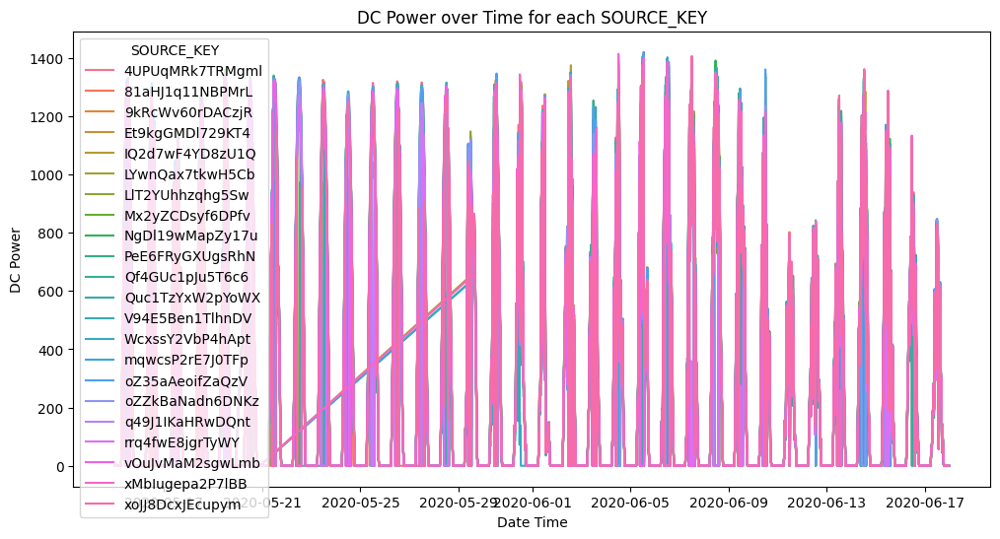

In [46]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=solar, x='DATE_TIME', y='DC_POWER', hue='SOURCE_KEY')

# Add labels and title
plt.xlabel('Date Time')
plt.ylabel('DC Power')
plt.title('DC Power over Time for each SOURCE_KEY')

# Show the plot
plt.show()


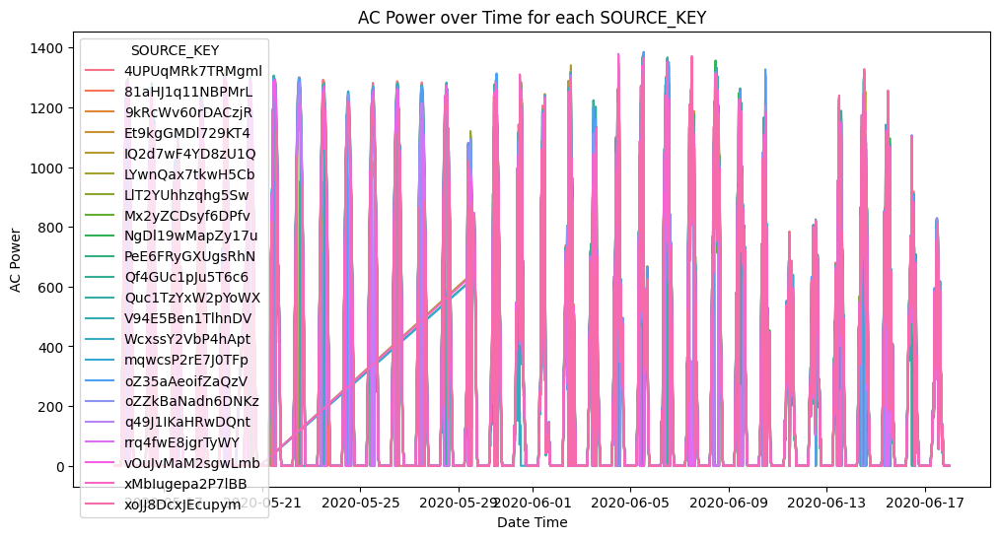

In [47]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=solar, x='DATE_TIME', y='AC_POWER', hue='SOURCE_KEY')

# Add labels and title
plt.xlabel('Date Time')
plt.ylabel('AC Power')
plt.title('AC Power over Time for each SOURCE_KEY')

# Show the plot
plt.show()


## Solar Plant Performance Analysis: Key Insights and Anomalies

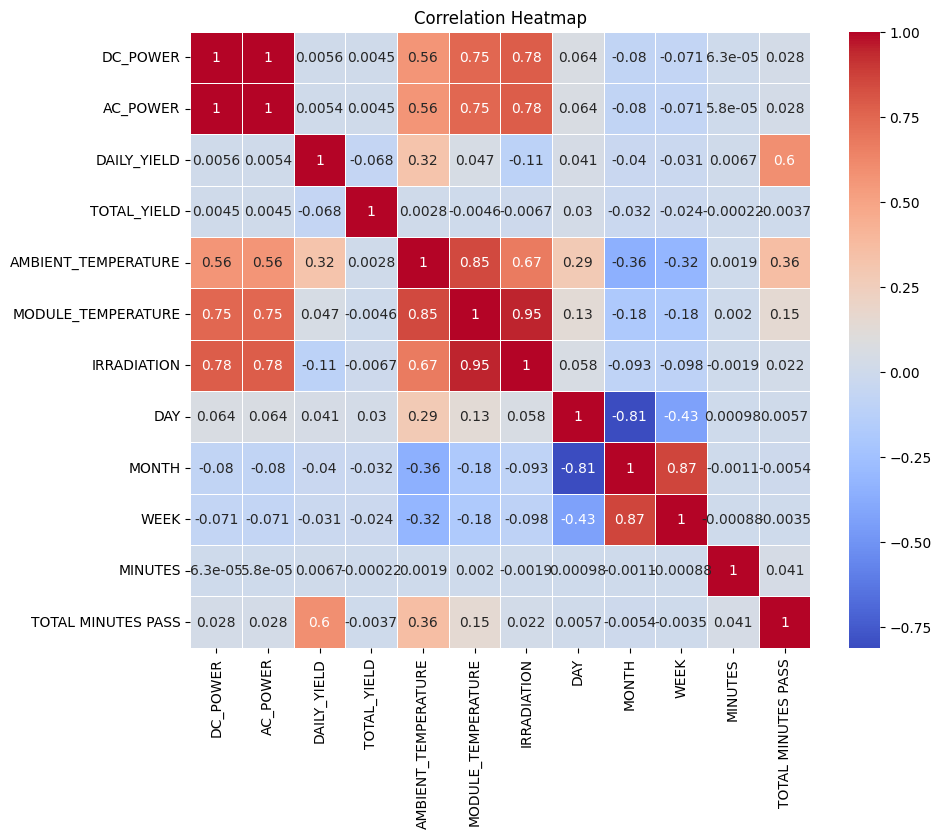

In [48]:
numeric_columns = solar.select_dtypes(include=np.number).columns.tolist()
corr_df = solar[numeric_columns].corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr_df, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

**DC Power and AC Power:**
Strong positive correlation observed
Indicates efficient power conversion in the inverters.

**Power and Irradiation:** High correlation between power output and solar irradiation
Demonstrates the direct impact of sunlight on energy production.

**Power and Temperature:** Correlation noted between power output and both module and ambient temperatures the temperature influence on solar panel efficiency.


### Daily Yield and AC Power¶

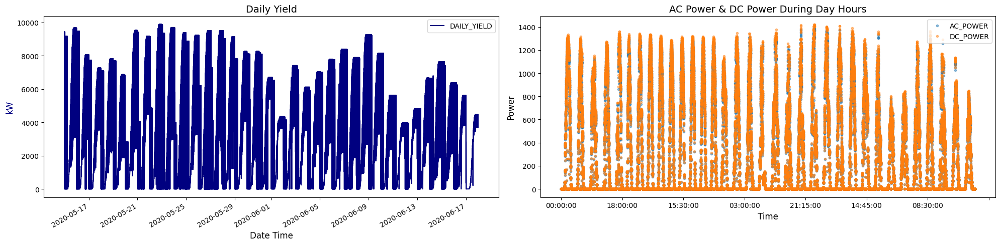

In [49]:
def plot_daily_yield_and_power(solar):
    fig, (ax1, ax2) = plt.subplots(ncols=2, nrows=1, figsize=(20, 5), dpi=100)

    # Daily yield plot
    solar.plot(x='DATE_TIME', y='DAILY_YIELD', color='navy', ax=ax1)
    ax1.set_title('Daily Yield', fontsize=14)
    ax1.set_ylabel('kW', color='navy', fontsize=12)
    ax1.set_xlabel('Date Time', fontsize=12)
    ax1.tick_params(axis='both', which='major', labelsize=10)

    # AC & DC power plot
    power_data = solar.set_index('TIME')[['AC_POWER', 'DC_POWER']]
    power_data.plot(style='.', ax=ax2, alpha=0.5)
    ax2.set_title('AC Power & DC Power During Day Hours', fontsize=14)
    ax2.set_ylabel('Power', fontsize=12)
    ax2.set_xlabel('Time', fontsize=12)
    ax2.tick_params(axis='both', which='major', labelsize=10)
    ax2.legend(fontsize=10)

    plt.tight_layout()
    plt.show()

plot_daily_yield_and_power(solar)

### Daily and Total Yield

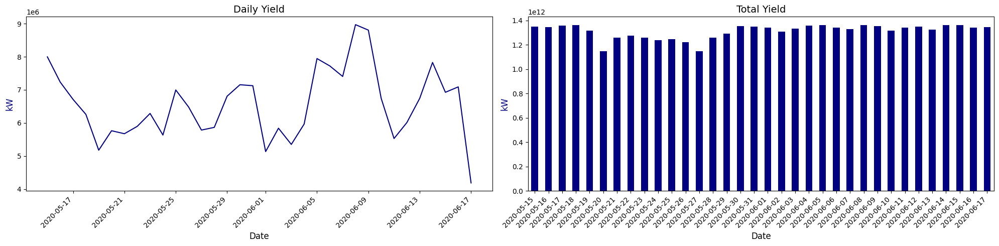

In [50]:
def plot_daily_yield_and_total_yield(solar):
    # Ensure DATE_TIME is a datetime object
    solar['date'] = pd.to_datetime(solar['DATE_TIME']).dt.date

    # Group by date and sum, exclude 'DATE_TIME' column from sum
    df_plant1_grouped = solar.groupby('date').sum(numeric_only=True)

    # Create subplots
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 5), dpi=100)

    # Plot Daily Yield
    df_plant1_grouped['DAILY_YIELD'].plot(ax=ax1, color='navy')
    ax1.set_title('Daily Yield', fontsize=14)
    ax1.set_ylabel('kW', color='navy', fontsize=12)
    ax1.set_xlabel('Date', fontsize=12)
    ax1.tick_params(axis='both', which='major', labelsize=10)

    # Plot Total Yield
    df_plant1_grouped['TOTAL_YIELD'].plot(kind='bar', ax=ax2, color='navy')
    ax2.set_title('Total Yield', fontsize=14)
    ax2.set_ylabel('kW', color='navy', fontsize=12)
    ax2.set_xlabel('Date', fontsize=12)
    ax2.tick_params(axis='both', which='major', labelsize=10)

    # Auto-format x-axis labels
    fig.autofmt_xdate(rotation=45)

    # Adjust layout
    plt.tight_layout()
    plt.show()

plot_daily_yield_and_total_yield(solar)

### TOTAL_YIELD by inverter (source key)
shows comparison of the total energy yield across all inverters. The bar chart shows individual inverter performance, and the line plot highlights the decreasing trend in yield. It is useful for identifying the most and least productive inverters, helping assess which inverters might need further investigation or maintenance.






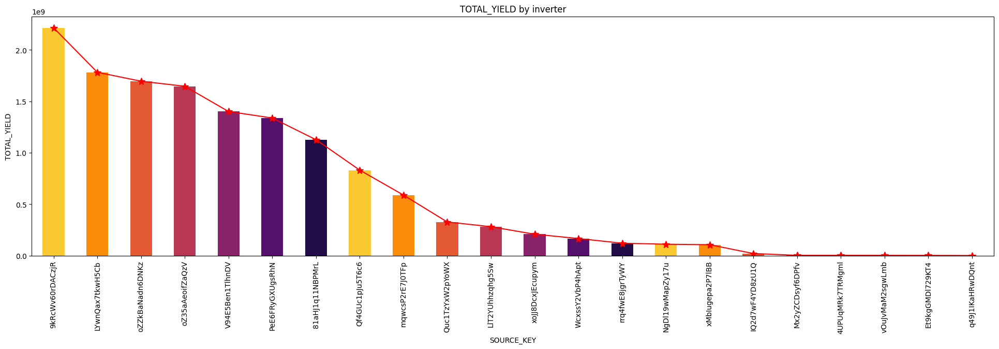

In [51]:
plt.figure(figsize=(24,6))
plt.title('TOTAL_YIELD by inverter')
plt.ylabel('TOTAL_YIELD')
solar.groupby('SOURCE_KEY')['TOTAL_YIELD'].mean().sort_values(ascending=False).plot(kind='line', marker='*', color='red', ms=10)
solar.groupby('SOURCE_KEY')['TOTAL_YIELD'].mean().sort_values(ascending=False).plot(kind='bar',color=sns.color_palette("inferno_r", 7))
plt.show()

### DAILY_YIELD & IRRADIATION

In [52]:
fig = px.scatter(solar, x = 'DAILY_YIELD', y = 'IRRADIATION', log_x=True,
                 hover_name="SOURCE_KEY", hover_data=["DAILY_YIELD", "IRRADIATION"],
                color = 'DAILY_YIELD', color_continuous_scale= 'rainbow',
                title = 'Quality or Quantity, That\'s the question')
fig.show()

In [53]:
dfpie = solar.loc[solar.groupby('SOURCE_KEY')['AMBIENT_TEMPERATURE'].idxmax()]
fig = px.bar(dfpie, x = 'SOURCE_KEY', y = 'AMBIENT_TEMPERATURE',
            text = 'SOURCE_KEY', color = 'DAILY_YIELD',
            title = 'Max AMBIENT_TEMPERATURE')
fig.show()

### Irradiation, Ambient and Module Temperature

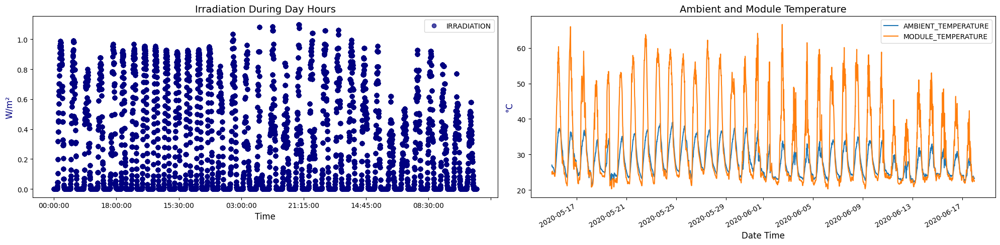

In [54]:
def plot_irradiation_and_temperature(solar):
    fig, (ax1, ax2) = plt.subplots(ncols=2, nrows=1, figsize=(20, 5), dpi=100)

    # Daily irradiation plot
    solar.plot(x='TIME', y='IRRADIATION', ax=ax1, style='o', color='navy', alpha=0.7)
    ax1.set_title('Irradiation During Day Hours', fontsize=14)
    ax1.set_ylabel('W/m²', color='navy', fontsize=12)
    ax1.set_xlabel('Time', fontsize=12)
    ax1.tick_params(axis='both', which='major', labelsize=10)

    # Temperature plot
    solar.set_index('DATE_TIME')[['AMBIENT_TEMPERATURE', 'MODULE_TEMPERATURE']].plot(ax=ax2)
    ax2.set_title('Ambient and Module Temperature', fontsize=14)
    ax2.set_ylabel('°C', color='navy', fontsize=12)
    ax2.set_xlabel('Date Time', fontsize=12)
    ax2.tick_params(axis='both', which='major', labelsize=10)
    ax2.legend(fontsize=10)

    plt.tight_layout()
    plt.show()

plot_irradiation_and_temperature(solar)


###Temperature:

In [55]:
solar['AMBIENT_TEMPERATURE'].describe()

count    67698.000000
mean        27.986756
std          4.021294
min         20.942385
25%         24.570349
50%         26.910352
75%         30.912601
max         39.181638
Name: AMBIENT_TEMPERATURE, dtype: float64

In [56]:
solar['MODULE_TEMPERATURE'].describe()

count    67698.000000
mean        32.607233
std         11.226446
min         20.265123
25%         23.685627
50%         27.433723
75%         40.019036
max         66.635953
Name: MODULE_TEMPERATURE, dtype: float64

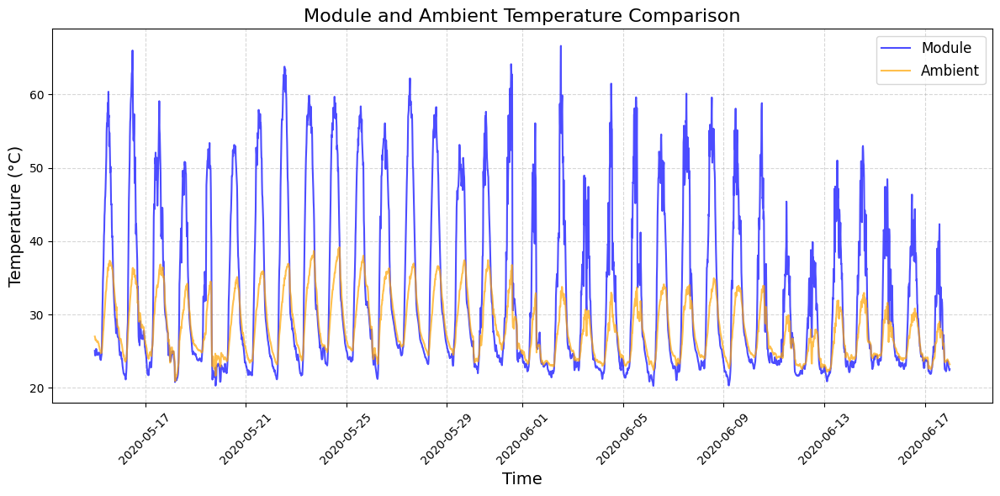

In [57]:
def plot_temperature(solar):
    plt.figure(figsize=(12, 6))

    # Plot Module and Ambient Temperature
    plt.plot(solar['DATE_TIME'], solar['MODULE_TEMPERATURE'], label="Module", color='blue', linestyle='-', alpha=0.7)
    plt.plot(solar['DATE_TIME'], solar['AMBIENT_TEMPERATURE'], label="Ambient", color='orange', linestyle='-',  alpha=0.7)

    # Add title and labels
    plt.title("Module and Ambient Temperature Comparison", fontsize=16)
    plt.xlabel("Time", fontsize=14)
    plt.ylabel("Temperature (°C)", fontsize=14)

    # Add grid and legend
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.legend(fontsize=12)

    # Rotate x-ticks for better readability
    plt.xticks(rotation=45)

    plt.tight_layout()
    plt.show()

plot_temperature(solar)

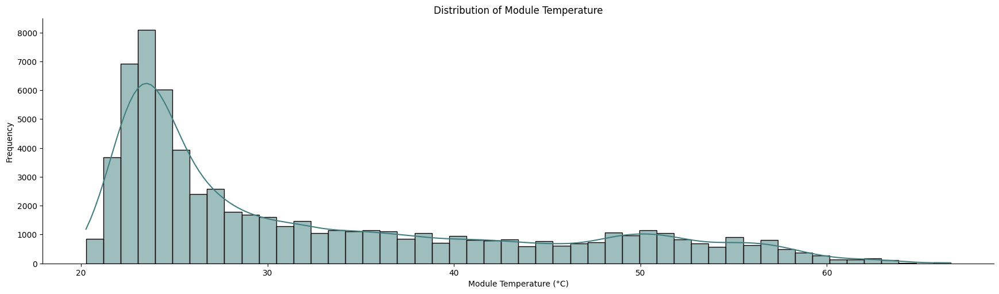

In [58]:
# Module Temperature
sns.displot(
    data=solar,
    x="MODULE_TEMPERATURE",
    kde=True,
    bins=50,
    color="#3F7F7F",
    height=5,
    aspect=3.5
)
plt.title("Distribution of Module Temperature")
plt.xlabel("Module Temperature (°C)")
plt.ylabel("Frequency")
plt.show()

**Explanation**: shows the frequency of different module temperatures recorded in the solar plant. Most of the temperatures fall between 25°C to 30°C, representing typical operating conditions. As temperatures increase beyond 40°C, they occur less frequently, with very high temperatures (around 60°C) being rare.





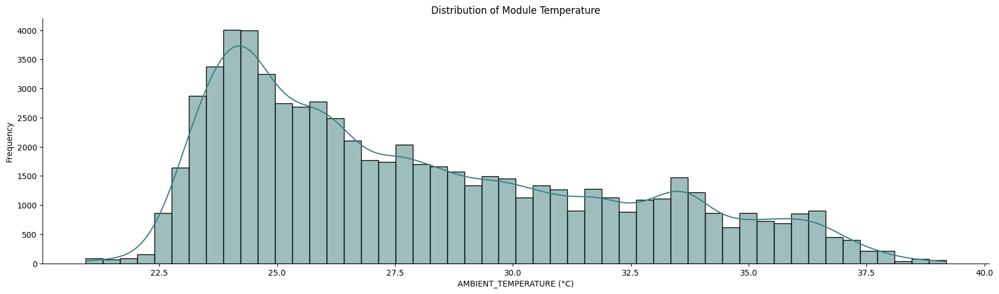

In [59]:
# AMBIENT Temperature
sns.displot(
    data=solar,
    x="AMBIENT_TEMPERATURE",
    kde=True,
    bins=50,
    color="#3F7F7F",
    height=5,
    aspect=3.5
)
plt.title("Distribution of Module Temperature")
plt.xlabel("AMBIENT_TEMPERATURE (°C)")
plt.ylabel("Frequency")
plt.show()

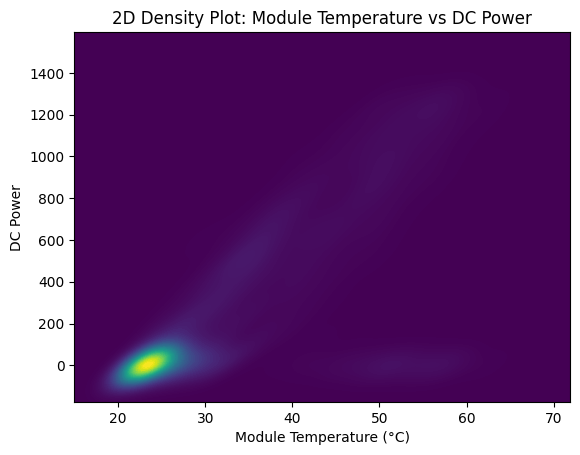

In [60]:
sns.kdeplot(
    data=solar,
    x="MODULE_TEMPERATURE",
    y="DC_POWER",
    cmap="viridis",
    fill=True,
    thresh=0,
    levels=100
)

plt.title("2D Density Plot: Module Temperature vs DC Power")
plt.xlabel("Module Temperature (°C)")
plt.ylabel("DC Power")
plt.show()


### Average temperature and Maximum temperature between module and ambient:

In [61]:
mod_amb_avg_diff = solar['MODULE_TEMPERATURE'].mean() - solar['AMBIENT_TEMPERATURE'].mean()
print(f"Average temperature difference between module and ambient: {mod_amb_avg_diff:.2f}°C")
mod_amb_max_diff = solar['MODULE_TEMPERATURE'].max() - solar['AMBIENT_TEMPERATURE'].max()
print(f"Maximum temperature difference between module and ambient: {mod_amb_max_diff:.2f}°C")

Average temperature difference between module and ambient: 4.62°C
Maximum temperature difference between module and ambient: 27.45°C


# Faults & Abnormalities detection in solar power plant generation


##Multiple Plotting of DC_POWER generation on per day

 The shape we observe is influenced by the sun’s angle relative to the solar panels. In the early morning, the sun is at its lowest point in the sky, meaning sunlight must pass through a thicker layer of the atmosphere to reach the panels. As sunlight travels through more atmosphere, more energy is absorbed, leaving less available for the panels to convert into electricity. However, at midday, when the sun is directly overhead, sunlight travels through less atmosphere, allowing the panels to absorb more energy and generate more electricity efficiently.

 **Note**: Reason for very high Fluctuation & Reduction in DC_POWER generation is due to fault in the **system** or may be fluctuation in **weather** or due to clouds etc. which need to be analyse further


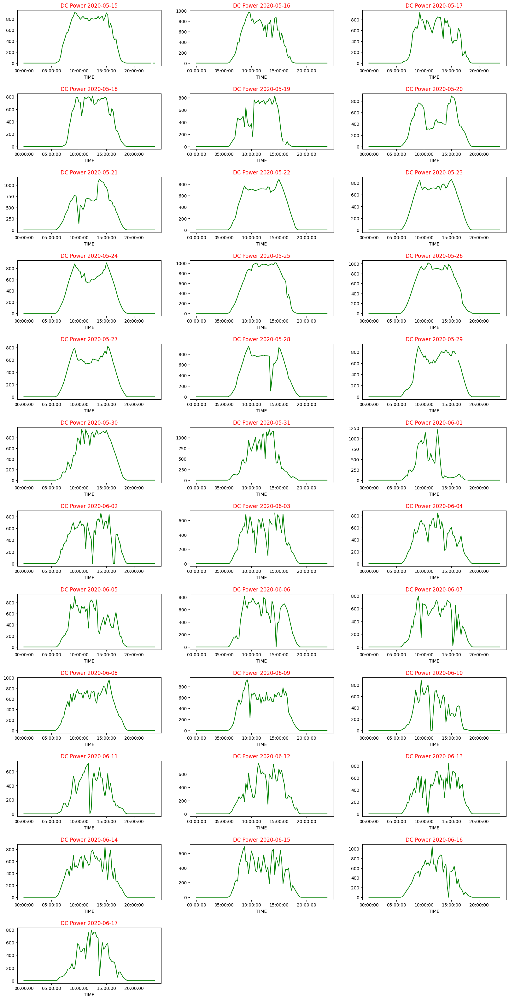

In [62]:
solar_dc = solar.pivot_table(values='DC_POWER', index='TIME', columns='DATE')

def Daywise_plot(data= None, row = None, col = None, title='DC Power'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40))

    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='green')
        ax.set_title('{} {}'.format(title, cols[i-1]),color='red')

Daywise_plot(data=solar_dc, row=12, col=3)

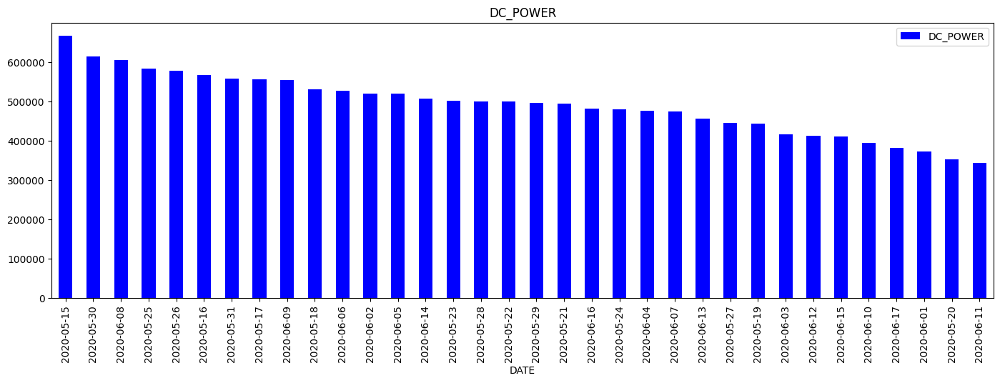

In [63]:
daily_irradiation = solar.groupby('DATE')['DC_POWER'].agg('sum')
daily_irradiation.sort_values(ascending=False).plot.bar(figsize=(17,5), legend=True,color='blue')
plt.title('DC_POWER')
plt.show()

## Multiple Plotting of IRRADIATION generation on per day

IRRADIATION graph pattern is looking very similar to the corresponding DC_POWER generation on per day basis.

In solar power plant DC_POWER or Output power is mostly depends on IRRADIATION .Or it is not wrong to say that it’s directly proportional.


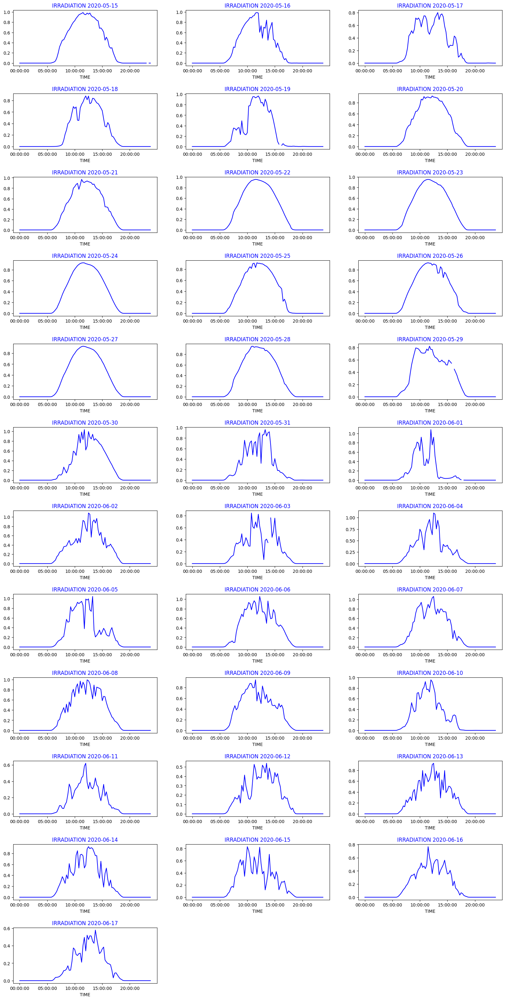

In [64]:
solar_irradiation = solar.pivot_table(values='IRRADIATION', index='TIME', columns='DATE')

def Daywise_plot(data= None, row = None, col = None, title='IRRADIATION'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40))

    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='blue')
        ax.set_title('{} {}'.format(title, cols[i-1]),color='blue')

Daywise_plot(data=solar_irradiation, row=12, col=3)


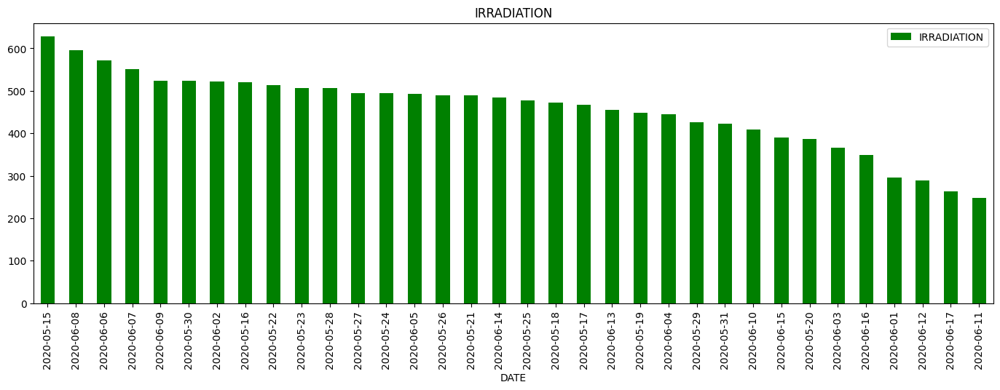

In [65]:
daily_irradiation = solar.groupby('DATE')['IRRADIATION'].agg('sum')
daily_irradiation.sort_values(ascending=False).plot.bar(figsize=(17,5), legend=True,color='green')
plt.title('IRRADIATION')
plt.show()

## Inverter wise

Analyzes how efficiently the inverters in a solar plant convert DC power (Direct Current) into AC power (Alternating Current)
so the Inverter loss is calculated as the percentage of DC power converted into AC power. This helps measure how well the inverter performs

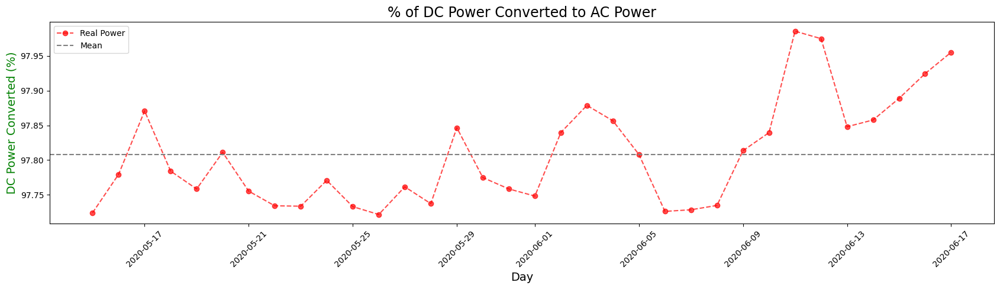

In [66]:
def plot_inverter_loss(solar):
    # Create a copy of the DataFrame
    loss_df = solar.copy()

    # Extract the date and group by day
    loss_df['Day'] = pd.to_datetime(loss_df['DATE_TIME']).dt.date
    loss_df = loss_df.groupby('Day').sum(numeric_only=True)

    # Calculate inverter loss
    loss_df['inverter_loss'] = (loss_df['AC_POWER'] / loss_df['DC_POWER']) * 100

    # Plot inverter loss
    plt.figure(figsize=(17, 5))
    loss_df['inverter_loss'].plot(style='o--', label='Real Power', color='red', alpha=0.7)

    # Plot mean line
    plt.axhline(loss_df['inverter_loss'].mean(), linestyle='--', color='gray', label='Mean')

    # Add titles and labels
    plt.title('% of DC Power Converted to AC Power', fontsize=17)
    plt.ylabel('DC Power Converted (%)', fontsize=14, color='green')
    plt.xlabel('Day', fontsize=14)
    plt.xticks(rotation=45)
    plt.legend()
    plt.tight_layout()
    plt.show()

plot_inverter_loss(solar)

### Solar Power Plant Inverter Efficiency Calculation
The inverter efficiency refers to how much dc power will be converted to ac power, as some of power will be lost during this transition in two forms.

In [67]:
solar_dc_power = solar[solar['DC_POWER'] > 0]['DC_POWER'].values
solar_ac_power = solar[solar['AC_POWER'] > 0]['AC_POWER'].values
solar_plant_eff = (np.max(solar_ac_power)/np.max(solar_dc_power ))*100
solar_loss= 100 - solar_plant_eff
print(f"Power ratio AC/DC (Efficiency) of Solar Power Plant:{solar_plant_eff:0.3f} %")
print(f"Power ratio AC/DC (loss) of Solar Power Plant: {solar_loss:0.3f} %")

Power ratio AC/DC (Efficiency) of Solar Power Plant:97.501 %
Power ratio AC/DC (loss) of Solar Power Plant: 2.499 %


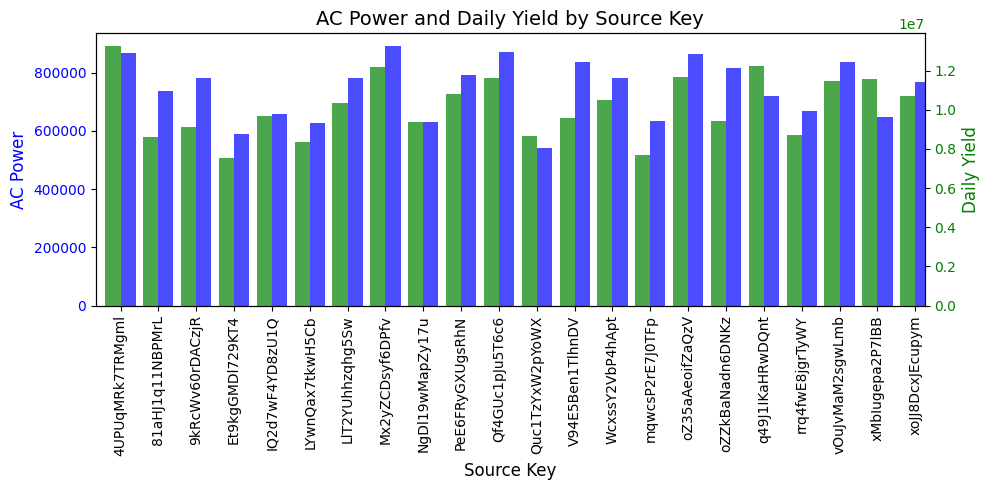

In [68]:
# Group data
ac_power = solar.groupby('SOURCE_KEY')[['AC_POWER', 'DAILY_YIELD']].sum()

# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(10, 5))

# Plot AC_POWER on the first y-axis
ac_power['AC_POWER'].plot(kind='bar', ax=ax1, color='blue', position=0, width=0.4, label='AC Power', alpha=0.7)
ax1.set_ylabel('AC Power', color='blue', fontsize=12)
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis
ax2 = ax1.twinx()

# Plot DAILY_YIELD on the second y-axis
ac_power['DAILY_YIELD'].plot(kind='bar', ax=ax2, color='green', position=1, width=0.4, label='Daily Yield', alpha=0.7)
ax2.set_ylabel('Daily Yield', color='green', fontsize=12)
ax2.tick_params(axis='y', labelcolor='green')

# Set title and labels
plt.title('AC Power and Daily Yield by Source Key', fontsize=14)
ax1.set_xlabel('Source Key', fontsize=12)

# Adjust layout
fig.tight_layout()

plt.show()

# Split The data

In [69]:
df = solar.copy()

In [70]:
df=df.set_index("DATE_TIME")

In [71]:
df=df.resample("H")["AMBIENT_TEMPERATURE","MODULE_TEMPERATURE","IRRADIATION","DC_POWER"].mean()
df.head()

,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DC_POWER
DATE_TIME,,,,
2020-05-15 00:00:00,26.767055,24.582656,0.0,0.0
2020-05-15 01:00:00,26.505909,25.172109,0.0,0.0
2020-05-15 02:00:00,26.296562,24.555514,0.0,0.0
2020-05-15 03:00:00,26.141691,24.627655,0.0,0.0
2020-05-15 04:00:00,25.509473,24.658230,0.0,0.0


In [72]:
X = df[['AMBIENT_TEMPERATURE','MODULE_TEMPERATURE','IRRADIATION']]
y = df['DC_POWER']

In [73]:
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV

X_train, X_test, y_train, y_test= train_test_split(X,y,train_size=0.8,random_state=2529)

### Linear Regression

In [74]:
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import mean_absolute_error

In [75]:
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

In [76]:
y_pred = lr.predict(X_test)

In [77]:
# Evaluate the Model
R2_Score = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)
mae_test = mean_absolute_error(y_test, y_pred)

print(f'LR Model R² Score: {R2_Score:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')
print(f'Mean Absolute Error: {mae_test:.2f}')

LR Model R² Score: 89.94%
Mean Squared Error: 9792.27
Mean Absolute Error: 72.34


In [78]:
# Cross-Validation
cv_scores = cross_val_score(lr, X, y, cv=5, scoring='r2')
print(f'Cross-Validation R² Scores: {cv_scores}')
print(f'Mean CV R² Score: {cv_scores.mean() * 100:.2f}%')

Cross-Validation R² Scores: [0.86337889 0.90467693 0.89329813 0.87491173 0.84898625]
Mean CV R² Score: 87.71%


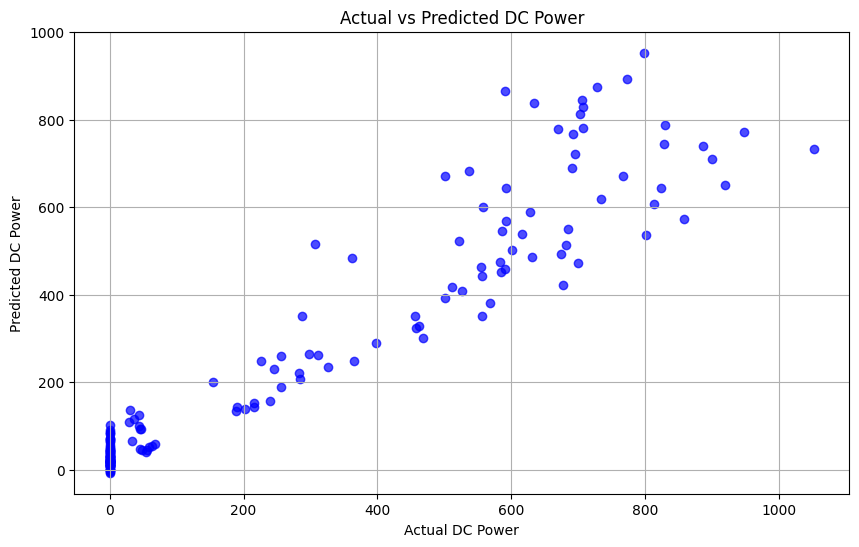

In [79]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.7, color='b')
plt.xlabel('Actual DC Power')
plt.ylabel('Predicted DC Power')
plt.title('Actual vs Predicted DC Power')
plt.grid(True)
plt.show()

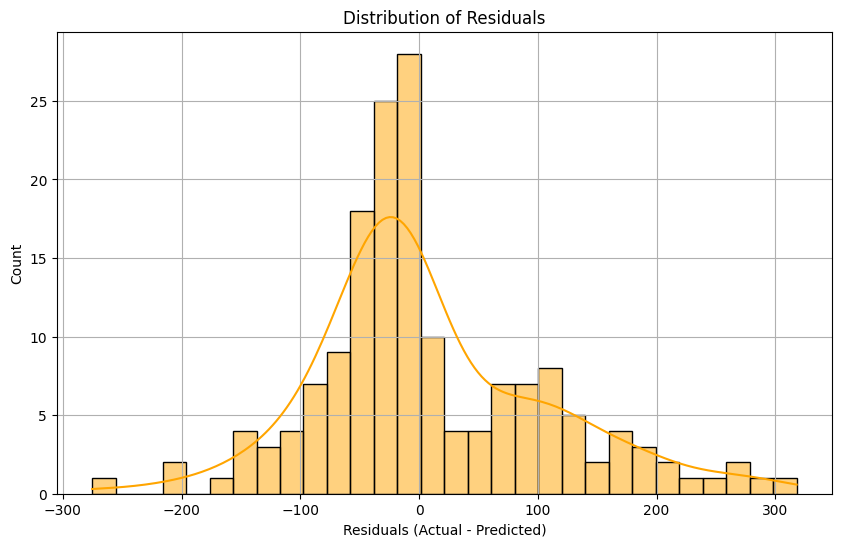

In [80]:
residuals = y_test - y_pred

plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, bins=30, color='orange')
plt.xlabel('Residuals (Actual - Predicted)')
plt.title('Distribution of Residuals')
plt.grid(True)
plt.show()

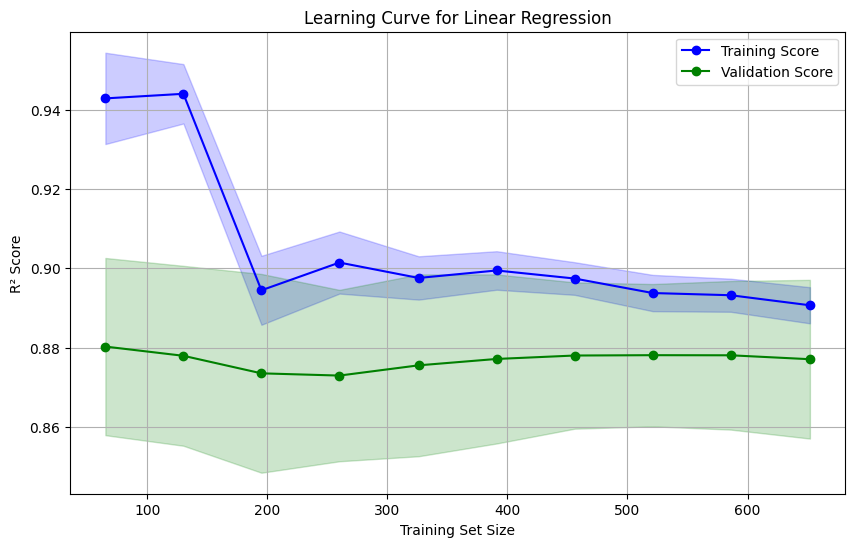

In [82]:

from sklearn.model_selection import learning_curve

# Generate Learning Curve Data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lr, X=X, y=y, cv=5, scoring='r2', n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate Means and Standard Deviations
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the Learning Curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')

# Add Shaded Area for Standard Deviations
plt.fill_between(train_sizes,
                 train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')
plt.fill_between(train_sizes,
                 test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

# Labels, Title, and Grid
plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for Linear Regression')
plt.legend(loc='best')
plt.grid(True)
plt.show()


i asked ch. and he told me to change the model

###  Regressor (Neural Network)

In [83]:
from sklearn.neural_network import MLPRegressor
# Initialize the MLP Regressor with two hidden layers (64, 64 neurons)
mlp = MLPRegressor(hidden_layer_sizes=(64, 64), activation='relu',
                   solver='adam', max_iter=500, random_state=42)

# Train the model
mlp.fit(X_train, y_train)

MLPRegressor(hidden_layer_sizes=(64, 64), max_iter=500, random_state=42)

In [84]:
# Predict on test data
y_pred = mlp.predict(X_test)


In [85]:
# Evaluate the Model
R2_Score = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)
mae_test = mean_absolute_error(y_test, y_pred)

print(f'LR Model R² Score: {R2_Score:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')
print(f'Mean Absolute Error: {mae_test:.2f}')

LR Model R² Score: 93.15%
Mean Squared Error: 6669.17
Mean Absolute Error: 50.37


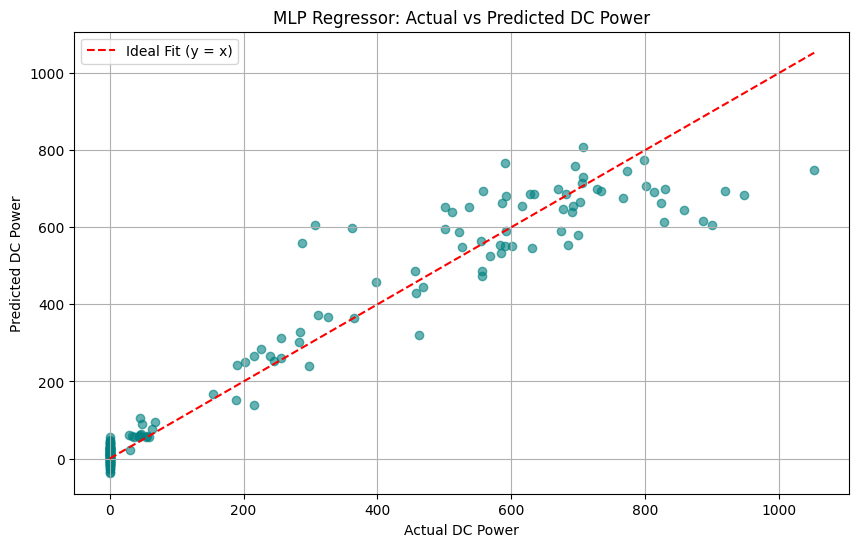

In [86]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='teal')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Ideal Fit (y = x)')
plt.xlabel('Actual DC Power')
plt.ylabel('Predicted DC Power')
plt.title('MLP Regressor: Actual vs Predicted DC Power')
plt.legend()
plt.grid(True)
plt.show()


The current model is not good based on the extremely negative R² score and large MSE.

/Users/afnanalamri/.pyenv/versions/3.10.6/envs/Renewable_Energy/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/afnanalamri/.pyenv/versions/3.10.6/envs/Renewable_Energy/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/afnanalamri/.pyenv/versions/3.10.6/envs/Renewable_Energy/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/afnanalamri/.pyenv/versions/3.10.6/envs/Renewable_Energy/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:690: Converg

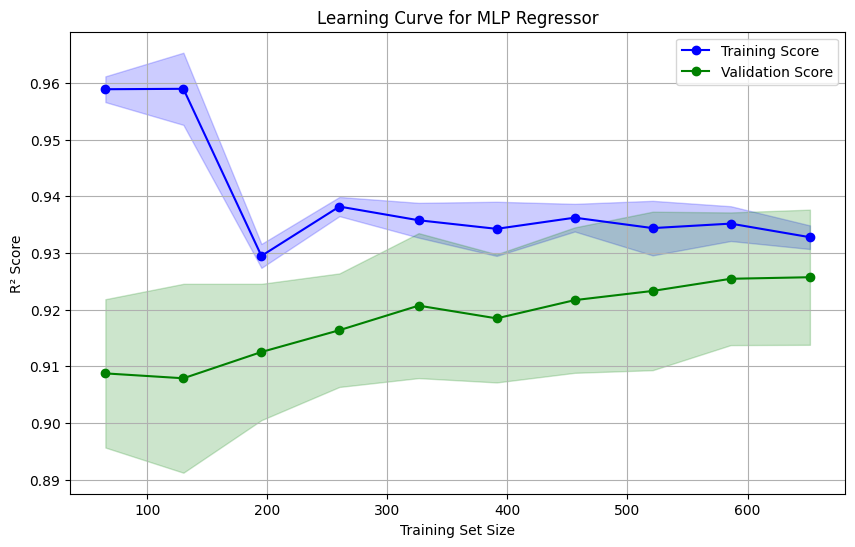

In [87]:
from sklearn.model_selection import  learning_curve

# Initialize the MLP Regressor
mlp_model = MLPRegressor(
    hidden_layer_sizes=(64, 64),
    activation='relu',
    solver='adam',
    max_iter=500,
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=mlp_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate the mean and standard deviation of training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for MLP Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


## LightGBM Regressor

In [88]:
from lightgbm import LGBMRegressor, early_stopping
from sklearn.model_selection import cross_val_score

In [89]:
# Initialize and train
lgb = LGBMRegressor(n_estimators=100, max_depth=5, learning_rate=0.1, random_state=42)
lgb.fit(X_train, y_train)

# Predict
y_pred = lgb.predict(X_test)

# Evaluate the Model
R2_Score = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)
mae_test = mean_absolute_error(y_test, y_pred)

print(f'LR Model R² Score: {R2_Score:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')
print(f'Mean Absolute Error: {mae_test:.2f}')


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000659 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 573
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info] Start training from score 244.412513
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

In [90]:
# Define the hyperparameters to tune
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2],
    'num_leaves': [20, 30, 40]
}

# Initialize
lgb = LGBMRegressor(random_state=42)

# Use GridSearchCV to find the best hyperparameters
grid_search = GridSearchCV(estimator=lgb, param_grid=param_grid,
                           cv=5, scoring='r2', n_jobs=-1, verbose=1)

# Train
grid_search.fit(X_train, y_train)

# best parameters
print(f'Best Parameters: {grid_search.best_params_}')


Fitting 5 folds for each of 81 candidates, totalling 405 fits
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001291 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001497 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 522, number of used features: 3
[LightGBM] [Info] Number of data points in the train set: 522, number of used features: 3
[LightGBM] [Info] Start training from score 253.650574
[LightGBM] [Info] Start training from score 245.572137
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.038159 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you

In [91]:
# Predict on the test data using the best model
y_pred_tuned = grid_search.best_estimator_.predict(X_test)

# Evaluate the Model
R2_Score = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)
mae_test = mean_absolute_error(y_test, y_pred)

print(f'LR Model R² Score: {R2_Score:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')
print(f'Mean Absolute Error: {mae_test:.2f}')

LR Model R² Score: 93.06%
Mean Squared Error: 6763.13
Mean Absolute Error: 39.22


In [92]:
cv_scores = cross_val_score(grid_search.best_estimator_, X, y, cv=5, scoring='r2')
print(f'Cross-Validation R² Scores: {cv_scores}')
print(f'Mean CV R² Score: {cv_scores.mean() * 100:.2f}%')


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000041 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 571
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info] Start training from score 244.176519
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

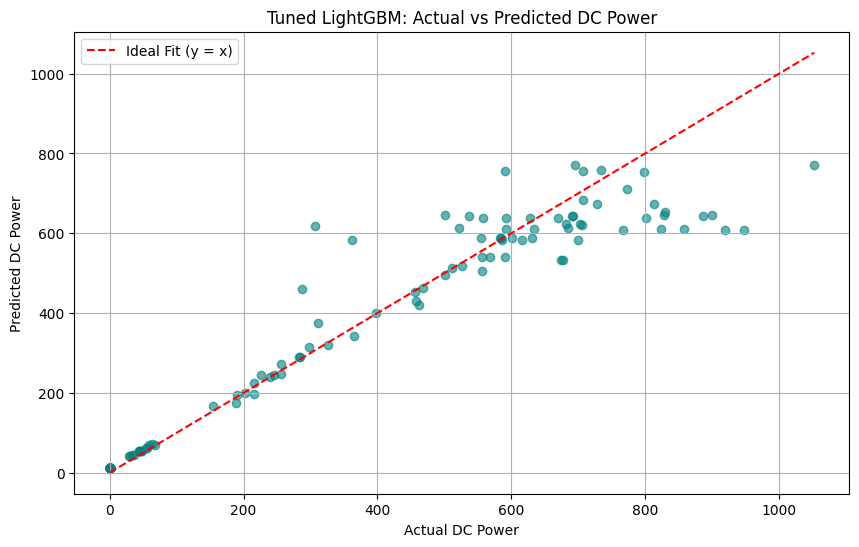

In [95]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred_tuned, alpha=0.6, color='teal')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Ideal Fit (y = x)')
plt.xlabel('Actual DC Power')
plt.ylabel('Predicted DC Power')
plt.title('Tuned LightGBM: Actual vs Predicted DC Power')
plt.legend()
plt.grid(True)
plt.show()


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014187 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 59
[LightGBM] [Info] Number of data points in the train set: 65, number of used features: 3
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002641 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 228
[LightGBM] [Info] Start training from score 270.841539
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006969 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 115
[LightGBM] [Info] Number of data points in the train set: 260, number of used features: 3
[LightGBM] [Info] Start training from score 284.765823

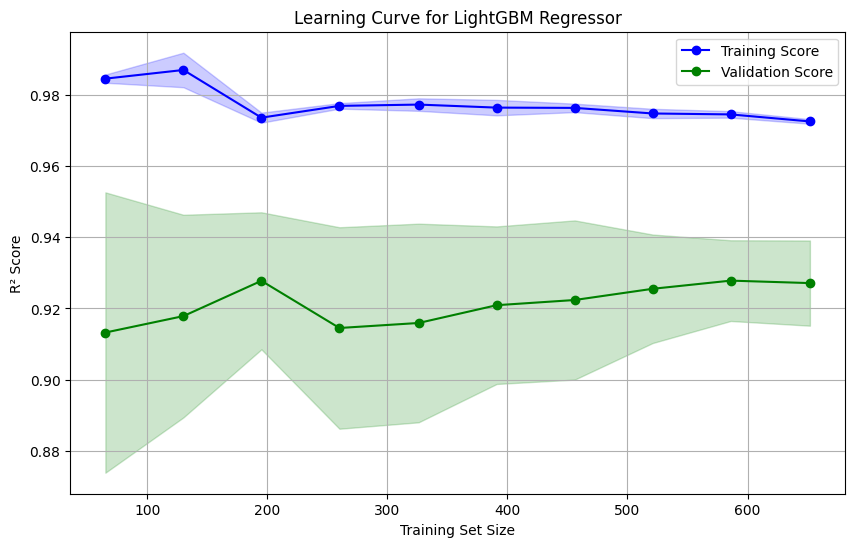

In [96]:
# Initialize the LightGBM Regressor
lgb_model = LGBMRegressor(
    n_estimators=100,
    max_depth=5,
    learning_rate=0.1,
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


### trying to fix the overfitting

In [97]:
lgb_model = LGBMRegressor(
    n_estimators=100,
    max_depth=5,
    learning_rate=0.1,
    reg_alpha=0.1,  # L1 regularization
    reg_lambda=0.1,  # L2 regularization
    random_state=42
)

# Fit the model
lgb_model.fit(X_train, y_train)
# This helps reduce overfitting by penalizing overly complex models.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 573
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info] Start training from score 244.412513
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

LGBMRegressor(max_depth=5, random_state=42, reg_alpha=0.1, reg_lambda=0.1)

In [98]:
from lightgbm import LGBMRegressor
from sklearn.model_selection import train_test_split
import lightgbm as lgb

lgb_model = LGBMRegressor(
    n_estimators=1000,
    max_depth=5,
    learning_rate=0.1,
    random_state=42
)

# Fit the model with early stopping
lgb_model.fit(
    X_train, y_train,
    eval_set=[(X_test, y_test)],
    eval_metric='rmse',
    # early_stopping_rounds=50,  # Stops if no improvement in 50 rounds
    # verbose=True
)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000049 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 573
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info] Start training from score 244.412513
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

LGBMRegressor(max_depth=5, n_estimators=1000, random_state=42)

In [99]:
# Make predictions using the trained model
y_pred = lgb_model.predict(X_test)


In [100]:
# Evaluate the model
from sklearn.metrics import r2_score, mean_squared_error

r2 = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)

print(f'LightGBM R² Score: {r2:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')

LightGBM R² Score: 91.56%
Mean Squared Error: 8220.76


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000457 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 115
[LightGBM] [Info] Number of data points in the train set: 130, number of used features: 3
[LightGBM] [Info] Start training from score 281.969615
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000454 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 59
[LightGBM] [Info] Number of data points in the train set: 65, number of used features: 3
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001148 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 171
[LightGBM] [Info] Start training from score 270.841539
[LightGBM] [Info] Number of data points in the train set: 195, 

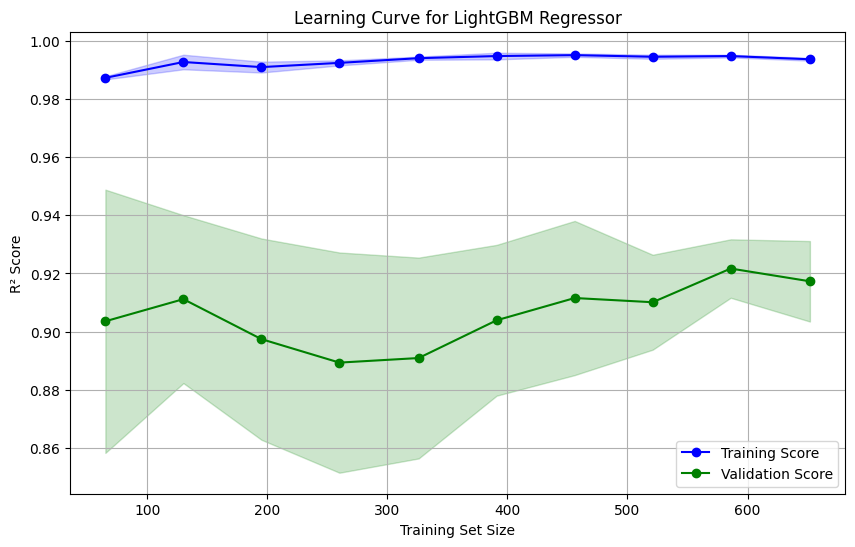

In [101]:
# Initialize the LightGBM Regressor with the final parameters
lgb_model = LGBMRegressor(
    n_estimators=1000,
    max_depth=5,
    learning_rate=0.1,
    reg_alpha=0.1,  # L1 regularization
    reg_lambda=0.1,  # L2 regularization
    random_state=42
)

# Generate the learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',  # Use R² as the evaluation metric
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)  # Vary training sizes from 10% to 100%
)

# Calculate the mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))

# Plot training score
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

# Plot validation score
plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

# Labels, title, and grid
plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


In [102]:
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,  # Make trees shallower
    learning_rate=0.05,  # Slower learning
    reg_alpha=1.0,  # Stronger L1 regularization
    reg_lambda=1.0,  # Stronger L2 regularization
    random_state=42
)


In [103]:
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,
    num_leaves=20,  # Fewer leaves per tree
    learning_rate=0.05,
    random_state=42
)


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.040543 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 59
[LightGBM] [Info] Number of data points in the train set: 65, number of used features: 3
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.030918 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 115
[LightGBM] [Info] Number of data points in the train set: 130, number of used features: 3
[LightGBM] [Info] Start training from score 270.841539
[LightGBM] [Info] Start training from score 281.969615
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.040641 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was

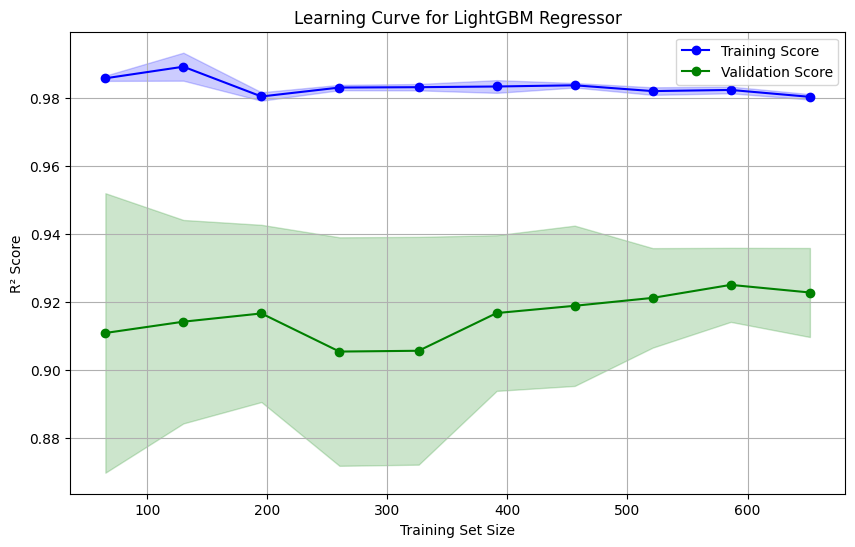

In [104]:
# Initialize the LightGBM Regressor with final parameters
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=5,
    learning_rate=0.05,
    reg_alpha=1.0,  # Stronger L1 regularization
    reg_lambda=1.0,  # Stronger L2 regularization
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,  # 5-fold cross-validation
    scoring='r2',  # Use R² as the metric
    n_jobs=-1,  # Use all available cores
    train_sizes=np.linspace(0.1, 1.0, 10)  # Training set sizes from 10% to 100%
)

# Calculate mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))

# Plot training score
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

# Plot validation score
plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

# Labels and title
plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


In [105]:
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,
    num_leaves=10,  # Fewer leaf nodes for simplicity
    learning_rate=0.05,
    reg_alpha=10.0,  # Stronger L1 regularization
    reg_lambda=10.0,  # Stronger L2 regularization
    random_state=42
)


In [106]:
lgb_model = LGBMRegressor(
    n_estimators=300,
    max_depth=2,
    num_leaves=5,  # Very few leaves
    learning_rate=0.05,
    random_state=42
)


In [107]:
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,
    num_leaves=20,
    learning_rate=0.05,
    reg_alpha=1.0,
    reg_lambda=1.0,
    feature_fraction=0.8,  # Use only 80% of features per iteration
    bagging_fraction=0.8,  # Use only 80% of data per iteration
    bagging_freq=5,  # Perform bagging every 5 iterations
    random_state=42
)


In [108]:
y_train_log = np.log1p(y_train)  # Apply log transformation
y_test_log = np.log1p(y_test)

# Train the model on transformed target
lgb_model.fit(X_train, y_train_log)
y_pred_log = lgb_model.predict(X_test)

# Reverse the log transformation for evaluation
y_pred = np.expm1(y_pred_log)


[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002907 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 573
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info]

In [109]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'max_depth': [2, 3, 4],
    'num_leaves': [5, 10, 20],
    'learning_rate': [0.01, 0.05, 0.1],
    'reg_alpha': [1.0, 10.0],
    'reg_lambda': [1.0, 10.0]
}

grid_search = GridSearchCV(estimator=LGBMRegressor(n_estimators=300, random_state=42),
                           param_grid=param_grid, cv=3, scoring='r2', n_jobs=-1)

grid_search.fit(X_train, y_train)
print(f'Best Parameters: {grid_search.best_params_}')


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000036 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 378
[LightGBM] [Info] Number of data points in the train set: 434, number of used features: 3
[LightGBM] [Info] Start training from score 227.770128
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will b

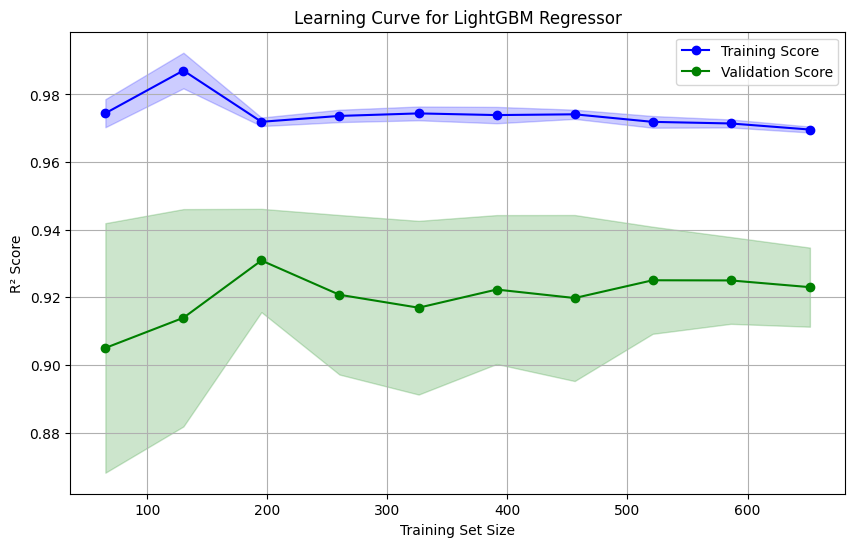

In [110]:
# Initialize the LightGBM Regressor with adjusted parameters
lgb_model = LGBMRegressor(
    n_estimators=500,
    max_depth=3,
    num_leaves=10,
    learning_rate=0.05,
    reg_alpha=10.0,
    reg_lambda=10.0,
    feature_fraction=0.8,
    bagging_fraction=0.8,
    bagging_freq=5,
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and std of scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))

plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


### fixed

In [111]:
lgb_model = LGBMRegressor(
    n_estimators=300,
    max_depth=2,
    num_leaves=5,
    learning_rate=0.05,
    reg_alpha=10.0,
    reg_lambda=10.0,
    feature_fraction=0.8,
    bagging_fraction=0.8,
    bagging_freq=5,
    random_state=42
)


In [112]:
reg_alpha=130.0
reg_lambda=130.0


[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000021 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 59
[LightGBM] [Info] Number of data points in the train set: 65, number of used features: 3
[LightGBM] [Info] S

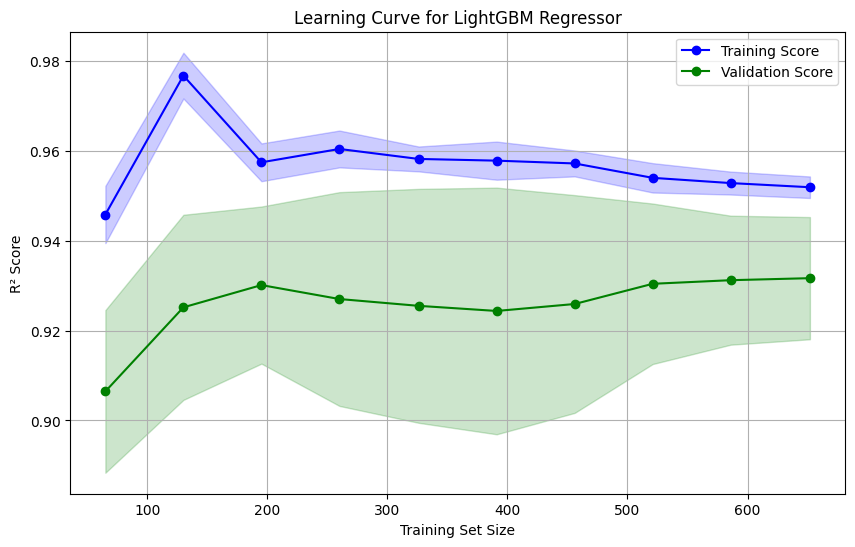

In [113]:
# Initialize LightGBM Regressor with tuned hyperparameters
lgb_model = LGBMRegressor(
    n_estimators=300,
    max_depth=2,
    num_leaves=5,
    learning_rate=0.05,
    reg_alpha=130.0,
    reg_lambda=130.0,
    feature_fraction=0.8,
    bagging_fraction=0.8,
    bagging_freq=3,
    random_state=42
)

# Generate learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model,
    X=X,
    y=y,
    cv=5,
    scoring='r2',
    n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)  # Training set sizes from 10% to 100%
)

# Calculate mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)


plt.figure(figsize=(10, 6))


plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')


plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')


plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


In [114]:
for size, train_score, val_score in zip(train_sizes, train_scores_mean, test_scores_mean):
    print(f"Training Size: {size}, Training R²: {train_score:.4f}, Validation R²: {val_score:.4f}")


Training Size: 65, Training R²: 0.9459, Validation R²: 0.9065
Training Size: 130, Training R²: 0.9768, Validation R²: 0.9252
Training Size: 195, Training R²: 0.9575, Validation R²: 0.9301
Training Size: 260, Training R²: 0.9604, Validation R²: 0.9270
Training Size: 326, Training R²: 0.9582, Validation R²: 0.9255
Training Size: 391, Training R²: 0.9578, Validation R²: 0.9244
Training Size: 456, Training R²: 0.9572, Validation R²: 0.9259
Training Size: 521, Training R²: 0.9540, Validation R²: 0.9304
Training Size: 586, Training R²: 0.9529, Validation R²: 0.9312
Training Size: 652, Training R²: 0.9519, Validation R²: 0.9317


In [115]:
lgb_model.fit(X_train, y_train)
y_pred = lgb_model.predict(X_test)

r2 = r2_score(y_test, y_pred)
print(f'Final R² Score: {r2:.4f}')

[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000243 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 573
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info]

In [116]:
# Evaluate the Model
R2_Score = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)
mae_test = mean_absolute_error(y_test, y_pred)

print(f'LR Model R² Score: {R2_Score:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')
print(f'Mean Absolute Error: {mae_test:.2f}')

LR Model R² Score: 94.27%
Mean Squared Error: 5577.07
Mean Absolute Error: 37.49


#CatBoost Regressor

In [117]:
pip install catboost


Note: you may need to restart the kernel to use updated packages.


In [118]:
from catboost import CatBoostRegressor, Pool

In [119]:
# Initialize CatBoost Regressor
catboost_model = CatBoostRegressor(iterations=500, depth=8, learning_rate=0.1,
                                   loss_function='RMSE', verbose=50, random_state=42)

# Train the model
catboost_model.fit(X_train, y_train)


0:	learn: 278.0131940	total: 81.2ms	remaining: 40.5s
50:	learn: 58.9539301	total: 268ms	remaining: 2.36s
100:	learn: 44.9425392	total: 487ms	remaining: 1.93s
150:	learn: 34.7401471	total: 582ms	remaining: 1.34s
200:	learn: 28.2882417	total: 876ms	remaining: 1.3s
250:	learn: 23.7301867	total: 956ms	remaining: 948ms
300:	learn: 21.1460794	total: 1.03s	remaining: 679ms
350:	learn: 17.7964547	total: 1.1s	remaining: 466ms
400:	learn: 14.9868814	total: 1.17s	remaining: 289ms
450:	learn: 12.9320831	total: 1.24s	remaining: 135ms
499:	learn: 10.9348424	total: 1.31s	remaining: 0us


In [120]:
# Predict on test data
y_pred = catboost_model.predict(X_test)

# Evaluate the Model
R2_Score = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)
mae_test = mean_absolute_error(y_test, y_pred)

print(f'LR Model R² Score: {R2_Score:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')
print(f'Mean Absolute Error: {mae_test:.2f}')


LR Model R² Score: 92.78%
Mean Squared Error: 7031.78
Mean Absolute Error: 42.49


In [121]:
# Perform 5-fold cross-validation
cv_scores = cross_val_score(catboost_model, X, y, cv=5, scoring='r2')

print(f'Cross-Validation R² Scores: {cv_scores}')
print(f'Mean CV R² Score: {cv_scores.mean() * 100:.2f}%')


0:	learn: 275.1022450	total: 4.67ms	remaining: 2.33s
50:	learn: 58.0655738	total: 76.2ms	remaining: 671ms
100:	learn: 47.9430652	total: 147ms	remaining: 581ms
150:	learn: 39.2743484	total: 217ms	remaining: 501ms
200:	learn: 32.5636561	total: 303ms	remaining: 451ms
250:	learn: 26.7487761	total: 421ms	remaining: 418ms
300:	learn: 21.8446196	total: 491ms	remaining: 325ms
350:	learn: 17.9553190	total: 561ms	remaining: 238ms
400:	learn: 16.0742293	total: 635ms	remaining: 157ms
450:	learn: 13.4706228	total: 710ms	remaining: 77.1ms
499:	learn: 11.6264110	total: 779ms	remaining: 0us
0:	learn: 267.9784218	total: 2.19ms	remaining: 1.09s
50:	learn: 57.1874150	total: 78.7ms	remaining: 693ms
100:	learn: 41.8531039	total: 150ms	remaining: 593ms
150:	learn: 32.0454038	total: 219ms	remaining: 507ms
200:	learn: 25.0593508	total: 291ms	remaining: 433ms
250:	learn: 20.8856794	total: 370ms	remaining: 367ms
300:	learn: 17.7247727	total: 440ms	remaining: 291ms
350:	learn: 15.1001133	total: 511ms	remaining: 

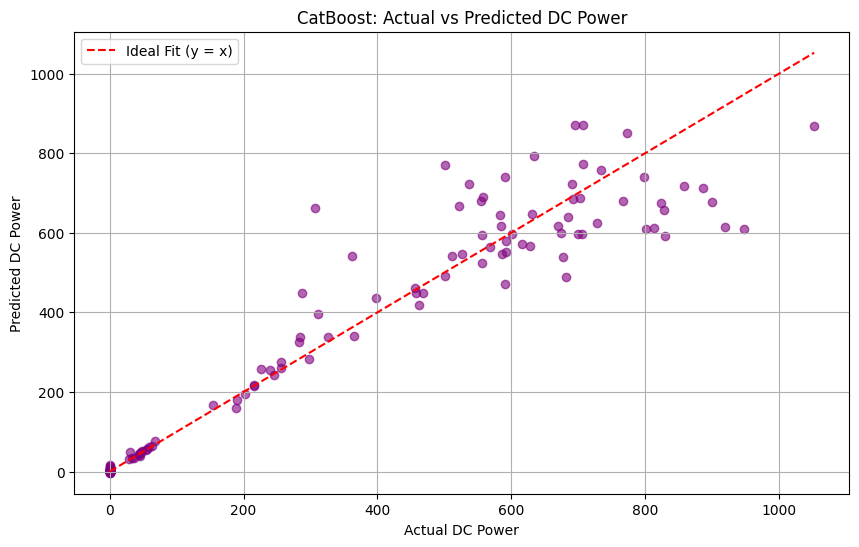

In [122]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='purple')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Ideal Fit (y = x)')
plt.xlabel('Actual DC Power')
plt.ylabel('Predicted DC Power')
plt.title('CatBoost: Actual vs Predicted DC Power')
plt.legend()
plt.grid(True)
plt.show()


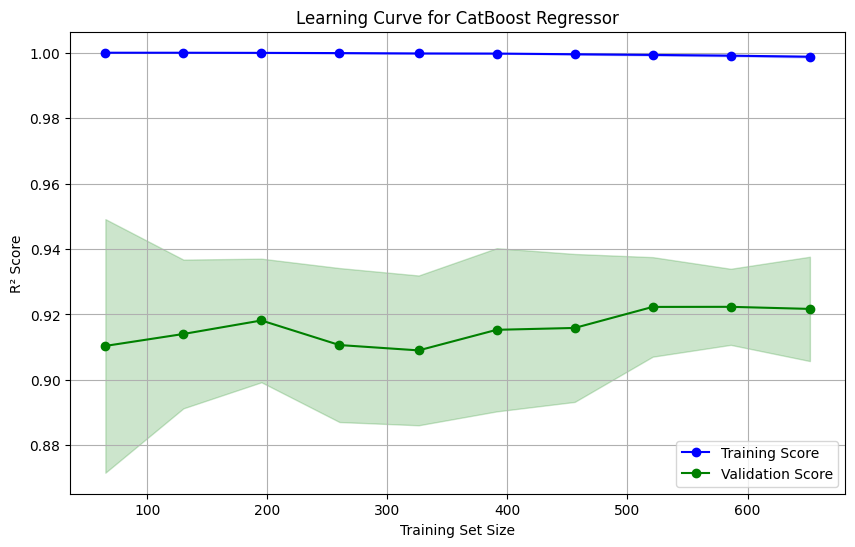

In [123]:
from sklearn.model_selection import learning_curve

# Create learning curve data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=CatBoostRegressor(iterations=500, depth=8, learning_rate=0.1,
                                loss_function='RMSE', random_state=42, verbose=0),
    X=X, y=y, cv=5, scoring='r2', n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 10)
)

# Calculate mean and standard deviation for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for CatBoost Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()


# random forest


## 1 R² Score: 94.25%

In [124]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV, learning_curve, train_test_split, cross_val_score


In [125]:
#  Initialize and Train the Model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

In [126]:
# Predict and Evaluate
y_pred = rf_model.predict(X_test)
# Evaluate the Model
R2_Score = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)
mae_test = mean_absolute_error(y_test, y_pred)

print(f'LR Model R² Score: {R2_Score:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')
print(f'Mean Absolute Error: {mae_test:.2f}')

LR Model R² Score: 92.89%
Mean Squared Error: 6926.05
Mean Absolute Error: 39.68


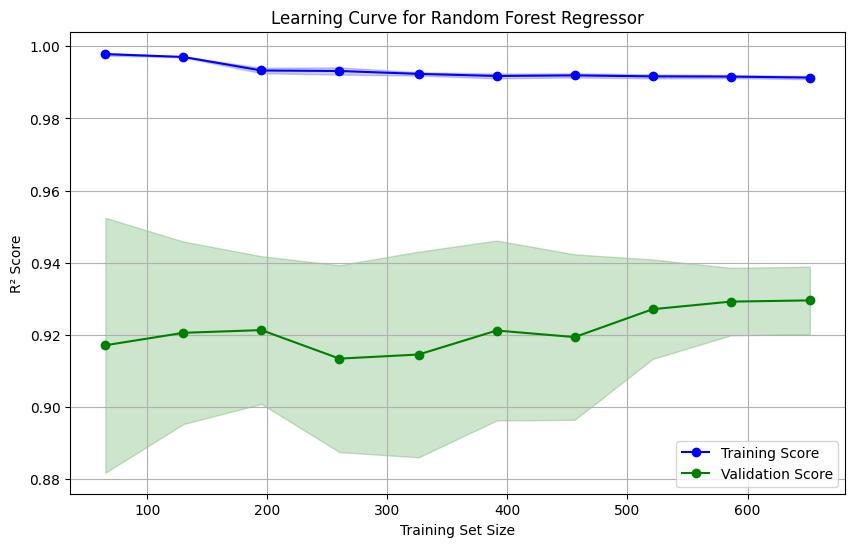

In [127]:
# Learning Curve
train_sizes, train_scores, test_scores = learning_curve(
    rf_model, X, y, cv=5, scoring='r2', n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plotting the Learning Curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for Random Forest Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()

## *2* R² Score: 0.8612

In [128]:
from sklearn.pipeline import Pipeline  # Correct import for Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV, train_test_split, learning_curve
from sklearn.metrics import r2_score, mean_squared_error
import matplotlib.pyplot as plt
# Step 2: Define the pipeline
pipeline = Pipeline([
    ('randomforestregressor', RandomForestRegressor(random_state=42))
])


In [129]:
# Step 3: Set up the hyperparameter grid
param_grid = {
    'randomforestregressor__n_estimators': [100, 200],  # Correct parameter naming
    'randomforestregressor__max_depth': [5, 8],
    'randomforestregressor__min_samples_split': [10, 15],
    'randomforestregressor__min_samples_leaf': [5, 10],
    'randomforestregressor__max_features': ['sqrt', 'log2']
}


In [130]:
# Step 4: Perform GridSearchCV
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='r2', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)


Fitting 5 folds for each of 32 candidates, totalling 160 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('randomforestregressor',
                                        RandomForestRegressor(random_state=42))]),
             n_jobs=-1,
             param_grid={'randomforestregressor__max_depth': [5, 8],
                         'randomforestregressor__max_features': ['sqrt',
                                                                 'log2'],
                         'randomforestregressor__min_samples_leaf': [5, 10],
                         'randomforestregressor__min_samples_split': [10, 15],
                         'randomforestregressor__n_estimators': [100, 200]},
             scoring='r2', verbose=1)

In [131]:
# Evaluate the Best Model on Test Data
y_pred = grid_search.best_estimator_.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print(f'Best Parameters: {grid_search.best_params_}')
print(f'R² Score: {r2:.4f}')
print(f'Mean Squared Error: {mse:.2f}')

Best Parameters: {'randomforestregressor__max_depth': 8, 'randomforestregressor__max_features': 'sqrt', 'randomforestregressor__min_samples_leaf': 5, 'randomforestregressor__min_samples_split': 10, 'randomforestregressor__n_estimators': 200}
R² Score: 0.9361
Mean Squared Error: 6222.79


In [132]:
# Cross-Validation Scores
cv_scores = cross_val_score(grid_search.best_estimator_, X, y, cv=5, scoring='r2')
print(f'Cross-Validation R² Scores: {cv_scores}')
print(f'Mean CV R² Score: {cv_scores.mean():.4f}')


Cross-Validation R² Scores: [0.9411963  0.93800617 0.9400341  0.92156887 0.91411927]
Mean CV R² Score: 0.9310


In [133]:
# Learning Curve for RandomForestRegressor
train_sizes, train_scores, val_scores = learning_curve(
    grid_search.best_estimator_, X, y, cv=5, scoring='r2', n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

In [134]:
# Calculate Mean and Standard Deviation of Training and Validation Scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
val_mean = np.mean(val_scores, axis=1)
val_std = np.std(val_scores, axis=1)

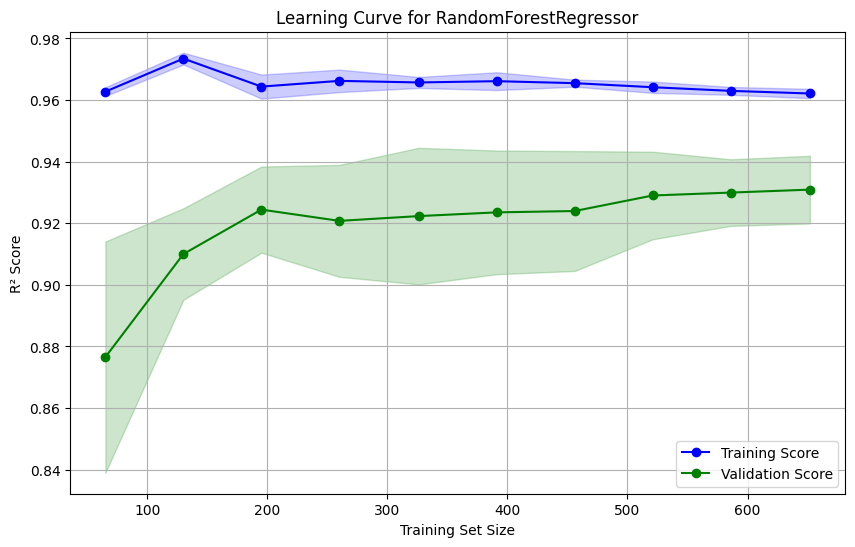

In [135]:
# Plot the Learning Curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.2, color='blue')

plt.plot(train_sizes, val_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, val_mean - val_std, val_mean + val_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for RandomForestRegressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()

##3 R² Score: 0.9425

In [136]:
# Step 2: Define Hyperparameter Grid
param_grid = {
    'n_estimators': [200, 300, 500],  # Increase n_estimators for better performance
    'max_depth': [10, 15, 20],        # Control overfitting
    'min_samples_split': [2, 5, 10],  # Min samples to split to prevent overfitting
}

In [137]:
# Step 3: Initialize and Grid Search with 5-Fold Cross-Validation
rf = RandomForestRegressor(random_state=42)
grid_search = GridSearchCV(rf, param_grid, cv=5, scoring='r2', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 27 candidates, totalling 135 fits


GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [10, 15, 20],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [200, 300, 500]},
             scoring='r2', verbose=1)

In [138]:

# Step 4: Evaluate the Best Model
y_pred = grid_search.best_estimator_.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print(f'Best Parameters: {grid_search.best_params_}')
print(f'R² Score: {r2:.4f}')
print(f'Mean Squared Error: {mse:.2f}')

Best Parameters: {'max_depth': 20, 'min_samples_split': 10, 'n_estimators': 500}
R² Score: 0.9332
Mean Squared Error: 6509.86


## 4 R² Score: 0.6789

In [139]:
from sklearn.feature_selection import SelectFromModel

# Step 2: Use RandomForest for Feature Selection
feature_selector = RandomForestRegressor(n_estimators=100, random_state=42)
feature_selector.fit(X_train, y_train)
sfm = SelectFromModel(feature_selector, threshold="mean")
X_train_selected = sfm.transform(X_train)
X_test_selected = sfm.transform(X_test)

In [140]:
# Step 3: Define Hyperparameter Grid
param_grid = {
    'n_estimators': [300, 500, 700],
    'max_depth': [10, 15, 20],
    'min_samples_split': [2, 5, 10]
}


In [141]:
# Step 4: Grid Search with Cross-Validation
rf = RandomForestRegressor(random_state=42)
grid_search = GridSearchCV(rf, param_grid, cv=5, scoring='r2', n_jobs=-1, verbose=1)
grid_search.fit(X_train_selected, y_train)


Fitting 5 folds for each of 27 candidates, totalling 135 fits


GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [10, 15, 20],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [300, 500, 700]},
             scoring='r2', verbose=1)

In [142]:
# Step 5: Evaluate the Best Model
y_pred = grid_search.best_estimator_.predict(X_test_selected)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print(f'Best Parameters: {grid_search.best_params_}')
print(f'R² Score: {r2:.4f}')
print(f'Mean Squared Error: {mse:.2f}')


Best Parameters: {'max_depth': 10, 'min_samples_split': 10, 'n_estimators': 700}
R² Score: 0.9479
Mean Squared Error: 5070.57


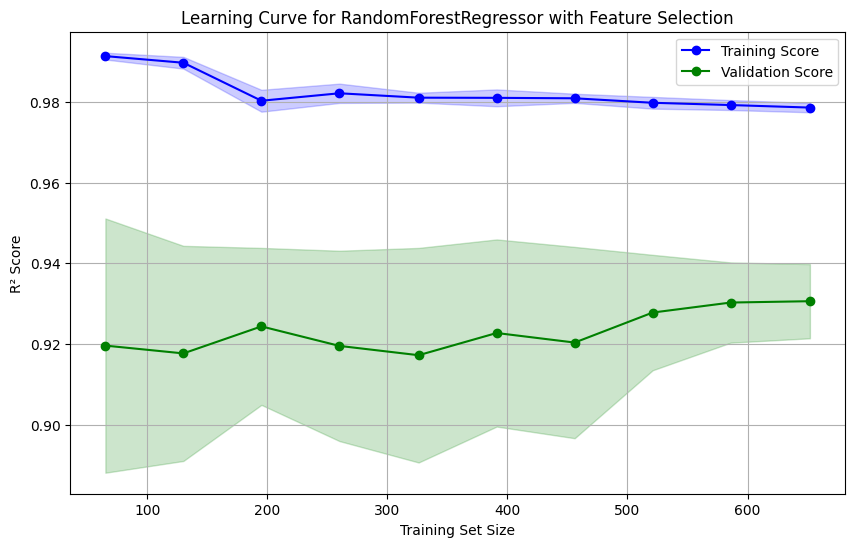

In [143]:
# Step 7: Learning Curve
train_sizes, train_scores, test_scores = learning_curve(
    grid_search.best_estimator_, X, y, cv=5, scoring='r2', n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 10)
)

train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='blue', label='Training Score')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2, color='blue')

plt.plot(train_sizes, test_scores_mean, 'o-', color='green', label='Validation Score')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for RandomForestRegressor with Feature Selection')
plt.legend(loc='best')
plt.grid(True)
plt.show()

#final LightGBM

In [145]:
from lightgbm import LGBMRegressor, early_stopping
from sklearn.model_selection import cross_val_score


In [146]:
# Initialize LightGBM Regressor
lgb_model = LGBMRegressor(
    n_estimators=300,
    max_depth=3,
    num_leaves=10,
    learning_rate=0.05,
    reg_alpha=130.0,
    reg_lambda=130.0,
    random_state=42
)


In [147]:
# Train the Model
lgb_model.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000024 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 573
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info] Start training from score 244.412513
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

LGBMRegressor(learning_rate=0.05, max_depth=3, n_estimators=300, num_leaves=10,
              random_state=42, reg_alpha=130.0, reg_lambda=130.0)

In [148]:
y_pred = lgb_model.predict(X_test)

In [149]:
# Evaluate the Model
R2_Score = r2_score(y_test, y_pred) * 100
mse = mean_squared_error(y_test, y_pred)
mae_test = mean_absolute_error(y_test, y_pred)

print(f'LR Model R² Score: {R2_Score:.2f}%')
print(f'Mean Squared Error: {mse:.2f}')
print(f'Mean Absolute Error: {mae_test:.2f}')

LR Model R² Score: 93.75%
Mean Squared Error: 6084.10
Mean Absolute Error: 35.85


In [150]:
# Generate Learning Curve Data
train_sizes, train_scores, test_scores = learning_curve(
    estimator=lgb_model, X=X, y=y, cv=5, scoring='r2', n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 10)
)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000372 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 228
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004264 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 59
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002144 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Number of data points in the train set: 260, number of used features: 3
[LightGBM] [Info] Total Bins 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 171
[LightGBM] [Info] Number of data points in the train set: 65, numbe

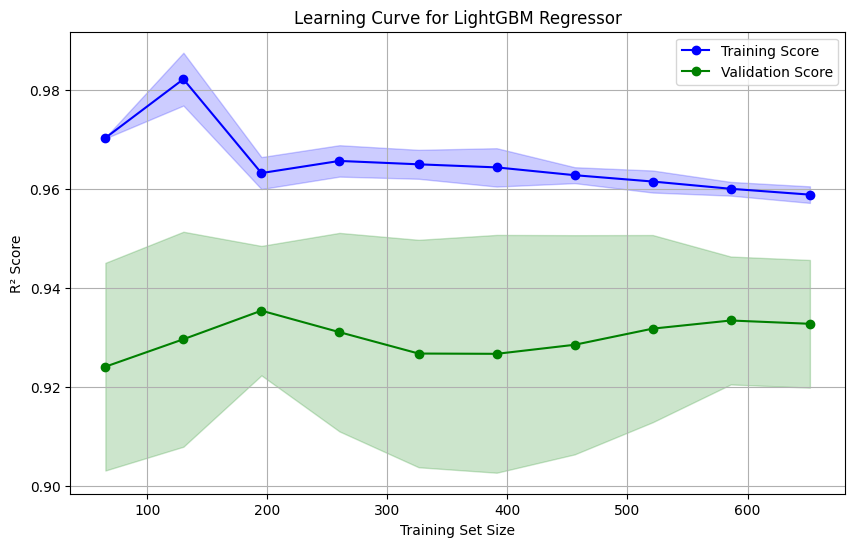

In [151]:
# Plot the Learning Curve
plt.figure(figsize=(10, 6))

plt.plot(train_sizes, np.mean(train_scores, axis=1), 'o-', color='blue', label='Training Score')
plt.plot(train_sizes, np.mean(test_scores, axis=1), 'o-', color='green', label='Validation Score')

# Add Shaded Area for Standard Deviation
plt.fill_between(train_sizes,
                 np.mean(train_scores, axis=1) - np.std(train_scores, axis=1),
                 np.mean(train_scores, axis=1) + np.std(train_scores, axis=1),
                 alpha=0.2, color='blue')
plt.fill_between(train_sizes,
                 np.mean(test_scores, axis=1) - np.std(test_scores, axis=1),
                 np.mean(test_scores, axis=1) + np.std(test_scores, axis=1),
                 alpha=0.2, color='green')

plt.xlabel('Training Set Size')
plt.ylabel('R² Score')
plt.title('Learning Curve for LightGBM Regressor')
plt.legend(loc='best')
plt.grid(True)
plt.show()

In [152]:
# Cross-Validation with 5 folds
cv_scores = cross_val_score(lgb_model, X, y, cv=5, scoring='r2')

# Print the cross-validation R² scores
print(f'Cross-Validation R² Scores: {cv_scores}')
print(f'Mean Cross-Validation R² Score: {cv_scores.mean() * 100:.2f}%')

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 571
[LightGBM] [Info] Number of data points in the train set: 652, number of used features: 3
[LightGBM] [Info] Start training from score 244.176519
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

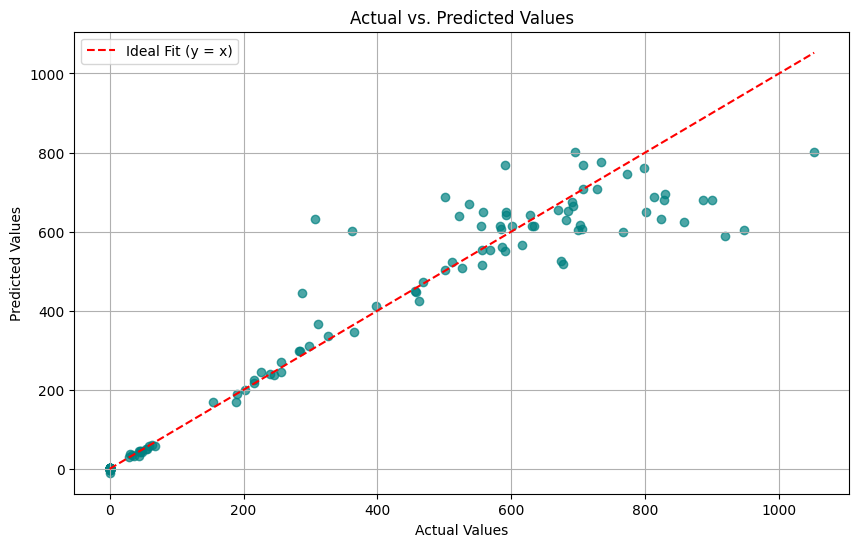

In [153]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.7, color='teal')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Ideal Fit (y = x)')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Actual vs. Predicted Values')
plt.legend()
plt.grid(True)
plt.show()